In [ ]:
import os
import gdown
import numpy as np
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import torch.nn.functional as F
import time
import math

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [ ]:
url = "https://drive.google.com/file/d/13eBK_LWxs4SkruFKH7glKK9jwQU1BkXK/view?usp=sharing"
gdown.download(url=url, output='lego_data.npz', quiet=False, fuzzy=True)

Downloading...
From: https://drive.google.com/uc?id=13eBK_LWxs4SkruFKH7glKK9jwQU1BkXK
To: /content/lego_data.npz
100%|██████████| 12.7M/12.7M [00:00<00:00, 30.3MB/s]


'lego_data.npz'

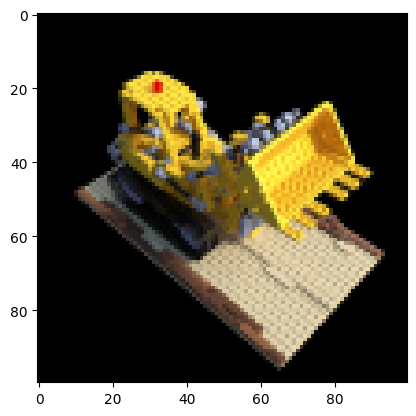

In [ ]:
# Load input images, poses, and intrinsics
data = np.load("lego_data.npz")

# Images
images = data["images"]

# Height and width of each image
height, width = images.shape[1:3]

# Camera extrinsics (poses)
poses = data["poses"]
poses = torch.from_numpy(poses).to(device)

# Camera intrinsics
intrinsics = data["intrinsics"]
intrinsics = torch.from_numpy(intrinsics).to(device)

# Hold one image out (for test).
test_image, test_pose = images[101], poses[101]
test_image = torch.from_numpy(test_image).to(device)

# Map images to device
images = torch.from_numpy(images[:100, ..., :3]).to(device)

plt.imshow(test_image.detach().cpu().numpy())
plt.show()

In [ ]:
def positional_encoding(x, num_frequencies=6, incl_input=True): #correct
    """
    Apply positional encoding to the input.

    Args:
    x (torch.Tensor): Input tensor to be positionally encoded.
      The dimension of x is [N, D], where N is the number of input coordinates,
      and D is the dimension of the input coordinate.
    num_frequencies (optional, int): The number of frequencies used in
     the positional encoding (default: 6).
    incl_input (optional, bool): If True, concatenate the input with the
        computed positional encoding (default: True).

    Returns:
    (torch.Tensor): Positional encoding of the input tensor.
    """

    results = []
    if incl_input:
        results.append(x)
    #############################  TODO 1(a) BEGIN  ############################
    # encode input tensor and append the encoded tensor to the list of results.
    N, D = x.size()
    frequencies = torch.arange(num_frequencies).float() 
    encoded = []
    for i in frequencies:
        sin_list = torch.sin(math.pow(2, i) * math.pi * x)
        cos_list = torch.cos(math.pow(2, i) * math.pi * x)
        encoded.append(sin_list)
        encoded.append(cos_list)
    results.extend(encoded)
    #############################  TODO 1(a) END  ##############################
    return torch.cat(results, dim=-1)

In [ ]:
def get_rays(height, width, intrinsics, w_R_c, w_T_c):

    """
    Compute the origin and direction of rays passing through all pixels of an image (one ray per pixel).

    Args:
    height: the height of an image.
    width: the width of an image.
    intrinsics: camera intrinsics matrix of shape (3, 3).
    w_R_c: Rotation matrix of shape (3,3) from camera to world coordinates.
    w_T_c: Translation vector of shape (3,1) that transforms

    Returns:
    ray_origins (torch.Tensor): A tensor of shape (height, width, 3) denoting the centers of
      each ray. Note that desipte that all ray share the same origin, here we ask you to return
      the ray origin for each ray as (height, width, 3).
    ray_directions (torch.Tensor): A tensor of shape (height, width, 3) denoting the
      direction of each ray.
    """

    device = intrinsics.device
    ray_directions = torch.zeros((height, width, 3), device=device)  # placeholder
    ray_origins = torch.zeros((height, width, 3), device=device)  # placeholder

    #############################  TODO 2.1 BEGIN  ##########################
    # Create a grid of pixel coordinates
    pixel_coordinates_y, pixel_coordinates_x = torch.meshgrid(
        torch.arange(0, height, device=device),
        torch.arange(0, width, device=device),
        indexing="ij"
    )
    ones_tensor = torch.ones_like(pixel_coordinates_x)
    stacked_coordinates = torch.stack([pixel_coordinates_x, pixel_coordinates_y, ones_tensor], -1)
    pixel_coordinates = stacked_coordinates.to(torch.float32)
    inv_intrinsics = torch.inverse(intrinsics)
    pixel_coordinates_expanded = pixel_coordinates.unsqueeze(-1)
    intermediate_result = torch.matmul(inv_intrinsics, pixel_coordinates_expanded)
    camera_coordinates = intermediate_result.squeeze(-1)
    ray_directions = torch.matmul(w_R_c, camera_coordinates.unsqueeze(-1)).squeeze(-1)
    w_T_c = w_T_c.squeeze()
    ray_origins = ray_origins + w_T_c[None, None, :]
    #############################  TODO 2.1 END  ############################
    return ray_origins, ray_directions

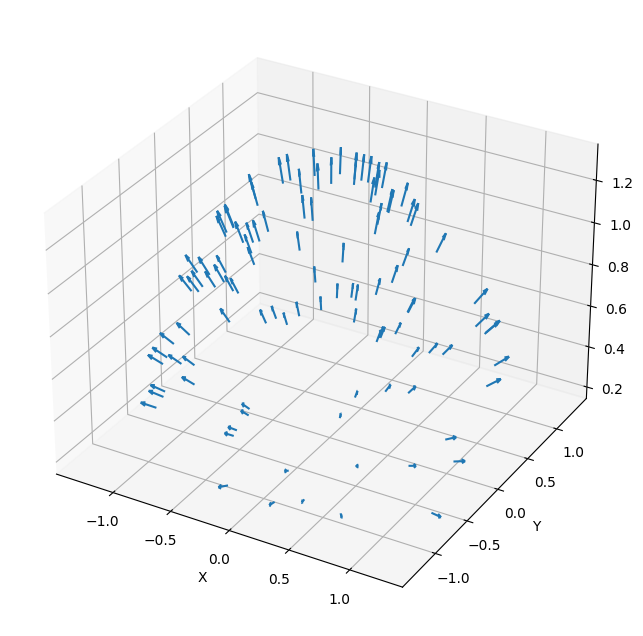

In [ ]:
def plot_all_poses(poses):

    #############################  TODO 2.1 BEGIN  ############################
  poses = torch.tensor(poses)
  N = poses.shape[0]
  origins = poses[:, :3, 3]
  directions = -poses[:, :3, 2]

    #############################  TODO 2.1 END  ############################

  ax = plt.figure(figsize=(12, 8)).add_subplot(projection='3d')
  _ = ax.quiver(origins[..., 0].flatten(),
                origins[..., 1].flatten(),
                origins[..., 2].flatten(),
                directions[..., 0].flatten(),
                directions[..., 1].flatten(),
                directions[..., 2].flatten(), length=0.12, normalize=True)
  ax.set_xlabel('X')
  ax.set_ylabel('Y')
  ax.set_zlabel('z')
  plt.show()

plot_all_poses(data['poses'])

In [ ]:
def stratified_sampling(ray_origins, ray_directions, near, far, samples):

    """
    Sample 3D points on the given rays. The near and far variables indicate the bounds of sampling range.

    Args:
    ray_origins: Origin of each ray in the "bundle" as returned by the
      get_rays() function. Shape: (height, width, 3).
    ray_directions: Direction of each ray in the "bundle" as returned by the
      get_rays() function. Shape: (height, width, 3).
    near: The 'near' extent of the bounding volume.
    far:  The 'far' extent of the bounding volume.
    samples: Number of samples to be drawn along each ray.

    Returns:
    ray_points: Query 3D points along each ray. Shape: (height, width, samples, 3).
    depth_points: Sampled depth values along each ray. Shape: (height, width, samples).
    """

    #############################  TODO 2.2 BEGIN  ############################
    height, width, _ = ray_origins.shape
    depth = torch.linspace(near, far, samples, device=ray_origins.device)
    # Create a 1x1xsamples tensor by reshaping the depth tensor
    reshaped_depth = depth.reshape(1, 1, samples)
    expanded_depth = reshaped_depth.expand(height, width, samples)
    depth_points = expanded_depth
    
    # Expanding dimensions for broadcasting
    expanded_origins = ray_origins.unsqueeze(-2)  
    expanded_depth = depth_points.unsqueeze(-1)  
    expanded_directions = ray_directions.unsqueeze(-2) 
    depth_times_directions = expanded_depth * expanded_directions
    # Calculating 3D positions
    ray_points = expanded_origins + depth_times_directions
    #############################  TODO 2.2 END  ############################
    return ray_points, depth_points

In [ ]:
class nerf_model(nn.Module):

    """
    Define a NeRF model comprising eight fully connected layers and following the
    architecture described in the NeRF paper.
    """

    def __init__(self, filter_size=256, num_x_frequencies=6, num_d_frequencies=3):
        super().__init__()

        #############################  TODO 2.3 BEGIN  ############################
        # for autograder compliance, please follow the given naming for your layers
        input_x = 3 + 2 * num_x_frequencies * 3
        input_d = 3 + 2 * num_d_frequencies * 3
        self.layers = nn.ModuleDict({
            'layer_1': nn.Linear(input_x, filter_size),
            'layer_2': nn.Linear(filter_size, filter_size),
            'layer_3': nn.Linear(filter_size, filter_size),
            'layer_4': nn.Linear(filter_size, filter_size),
            'layer_5': nn.Linear(filter_size, filter_size),
            'layer_6': nn.Linear(filter_size + input_x, filter_size),
            'layer_7': nn.Linear(filter_size, filter_size),
            'layer_8': nn.Linear(filter_size, filter_size),
            'layer_s': nn.Linear(filter_size, 1),
            'layer_9': nn.Linear(filter_size, filter_size),
            'layer_10': nn.Linear(filter_size + input_d, 128),  #doubt
            'layer_11': nn.Linear(128, 3)                       #doubt
        })


        #############################  TODO 2.3 END  ############################


    def forward(self, x, d):
        #############################  TODO 2.3 BEGIN  ############################
        # example of forward through a layer: y = self.layers['layer_1'](x)
        h = x
        for i in range(1, 9):
            h = F.relu(self.layers[f'layer_{i}'](h))
            if i == 5:
                h = torch.cat([h, x], dim=-1)
        sigma = F.relu(self.layers['layer_s'](h))
        h = self.layers['layer_9'](h)
        h = torch.cat([h, d], dim=-1)
        h = F.relu(self.layers['layer_10'](h))
        rgb = torch.sigmoid(self.layers['layer_11'](h))

        #############################  TODO 2.3 END  ############################
        return rgb, sigma

In [ ]:
def get_batches(ray_points, ray_directions, num_x_frequencies, num_d_frequencies):
  def get_chunks(inputs, chunksize=2 ** 15):
        return [inputs[i:i + chunksize] for i in range(0, inputs.shape[0], chunksize)]

  ray_directions_expanded = torch.unsqueeze(ray_directions, dim=2)
  ray_directions_broadcasted = ray_directions_expanded.expand(ray_directions_expanded.shape[0], ray_directions_expanded.shape[1], ray_points.shape[2], ray_directions_expanded.shape[3])

  ray_directions_norm = ray_directions_broadcasted / torch.norm(ray_directions_broadcasted, dim=-1, keepdim=True)
  reshaped_pts = ray_points.reshape(-1, 3)
  reshaped_directions = ray_directions_norm.reshape(-1, 3)
  encoded_ray_points = positional_encoding(reshaped_pts, num_x_frequencies, incl_input=True)
  encoded_ray_directions = positional_encoding(reshaped_directions, num_d_frequencies, incl_input=True)

  ray_points_batches = get_chunks(encoded_ray_points)
  ray_directions_batches = get_chunks(encoded_ray_directions)

  return ray_points_batches, ray_directions_batches

In [ ]:
def volumetric_rendering(rgb, s, depth_points):

    """
    Differentiably renders a radiance field, given the origin of each ray in the
    "bundle", and the sampled depth values along them.

    Args:
    rgb: RGB color at each query location (X, Y, Z). Shape: (height, width, samples, 3).
    sigma: Volume density at each query location (X, Y, Z). Shape: (height, width, samples).
    depth_points: Sampled depth values along each ray. Shape: (height, width, samples).

    Returns:
    rec_image: The reconstructed image after applying the volumetric rendering to every pixel.
    Shape: (height, width, 3)
    """

    #############################  TODO 2.4 BEGIN  ############################
    s = torch.relu(s)
    # Calculate the differences (deltas) between adjacent depth points
    deltas = depth_points[..., 1:] - depth_points[..., :-1]
    padding_tensor = torch.tensor([1e10], device=deltas.device)
    expanded_padding = padding_tensor.expand(deltas[..., :1].shape)
    deltas = torch.cat([deltas, expanded_padding], -1)
    alpha = 1 - torch.exp(-s * deltas)
    cat_result = torch.cat([torch.ones_like(alpha[..., :1]), 1 - alpha + 1e-10], -1)
    T = torch.cumprod(cat_result, dim=-1)[..., :-1]
    weights = alpha * T
    rec_image = torch.sum(weights[..., None] * rgb, dim=-2)
    #############################  TODO 2.4 END  ############################

    return rec_image

In [ ]:
url = "https://drive.google.com/file/d/1ag6MqSh3h4KY10Mcx5fKxt9roGNLLILK/view?usp=sharing"
gdown.download(url=url, output='sanity_volumentric.pt', quiet=False, fuzzy=True)
rbd = torch.load('sanity_volumentric.pt')

Downloading...
From: https://drive.google.com/uc?id=1ag6MqSh3h4KY10Mcx5fKxt9roGNLLILK
To: /content/sanity_volumentric.pt
100%|██████████| 120M/120M [00:01<00:00, 109MB/s]


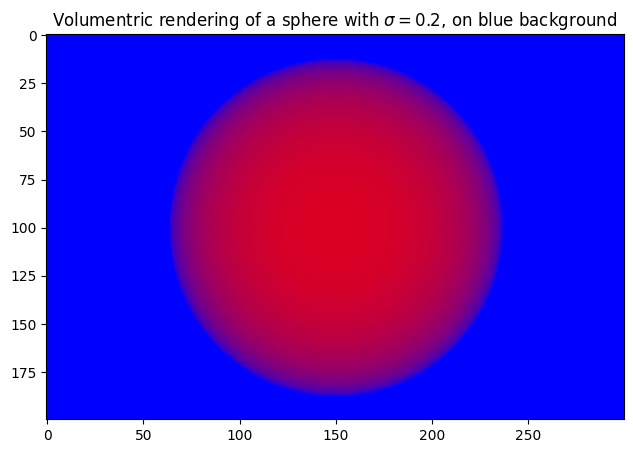

In [ ]:
r = rbd['rgb']
s = rbd['sigma']
depth_points = rbd['depth_points']
rec_image = volumetric_rendering(r, s, depth_points)

plt.figure(figsize=(10, 5))
plt.imshow(rec_image.detach().cpu().numpy())
plt.title(f'Volumentric rendering of a sphere with $\\sigma={0.2}$, on blue background')
plt.show()

In [ ]:
def one_forward_pass(height, width, intrinsics, pose, near, far, samples, model, num_x_frequencies, num_d_frequencies):

    #############################  TODO 2.5 BEGIN  ############################

    #compute all the rays from the image


    #sample the points from the rays


    #divide data into batches to avoid memory errors


    #forward pass the batches and concatenate the outputs at the end

      w_R_c = pose[:3,:3]
      w_T_c = pose[:3,3]
      ray_origins, ray_directions = get_rays(height, width, intrinsics, w_R_c, w_T_c)

      #sample the points from the rays
      ray_points, depth_points = stratified_sampling(ray_origins, ray_directions, near, far, samples)

      #divide data into batches to avoid memory errors
      ray_points_batches, ray_directions_batches = get_batches(ray_points, ray_directions, num_x_frequencies, num_d_frequencies)


      #forward pass the batches and concatenate the outputs at the end
      rgb_list, density_list = [], []
      for i in range(len(ray_directions_batches)):
          rgb, density = model.forward(ray_points_batches[i], ray_directions_batches[i])
          rgb_list.append(rgb)
          density_list.append(density)

      rgb_list = torch.cat(rgb_list)
      rgb_list = rgb_list.reshape(height, width, samples, 3) #(H,W,N,3)

      density_list = torch.cat(density_list)
      density_list = density_list.reshape(height, width, samples) #(H,W,N)

      # Apply volumetric rendering to obtain the reconstructed image
      rec_image = volumetric_rendering(rgb_list, density_list, depth_points).to(device)

      #############################  TODO 2.5 END  ############################

      return rec_image

Iteration 0  Loss: 0.1170  PSNR: 7.48  Time: 0.10 secs per iter,  0.04 mins in total


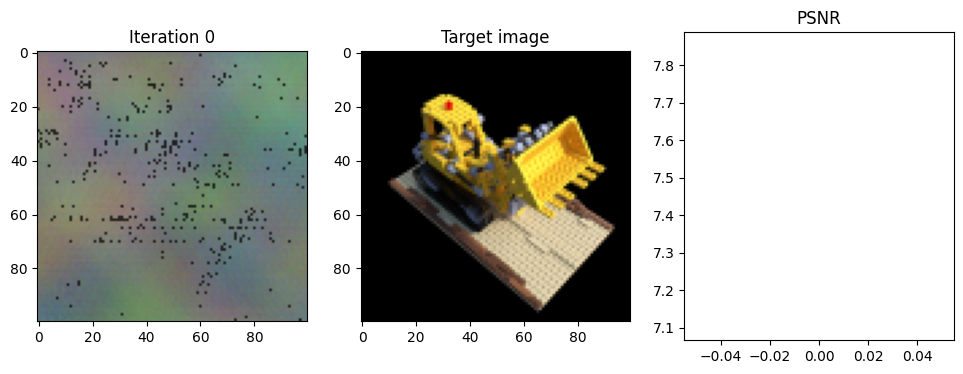

Iteration 25  Loss: 0.0560  PSNR: 10.68  Time: 0.88 secs per iter,  0.41 mins in total


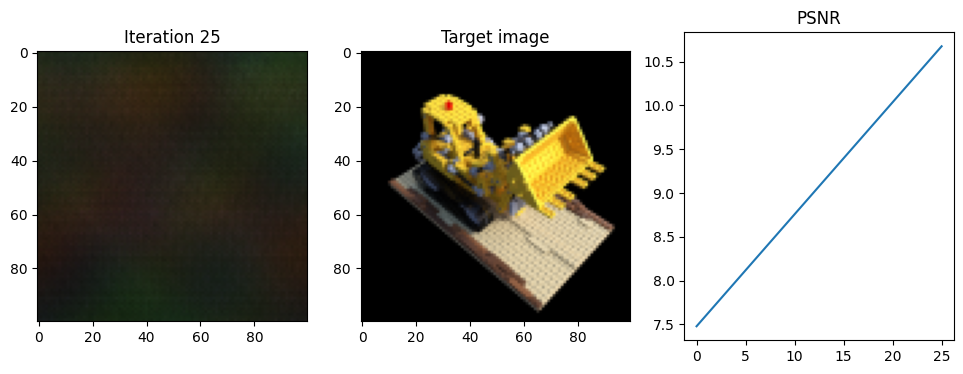

Iteration 50  Loss: 0.1050  PSNR: 10.89  Time: 0.93 secs per iter,  0.80 mins in total


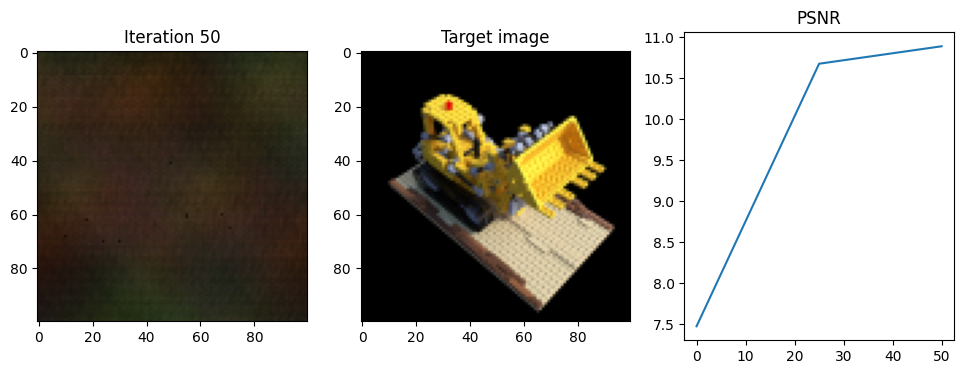

Iteration 75  Loss: 0.0557  PSNR: 11.04  Time: 0.98 secs per iter,  1.21 mins in total


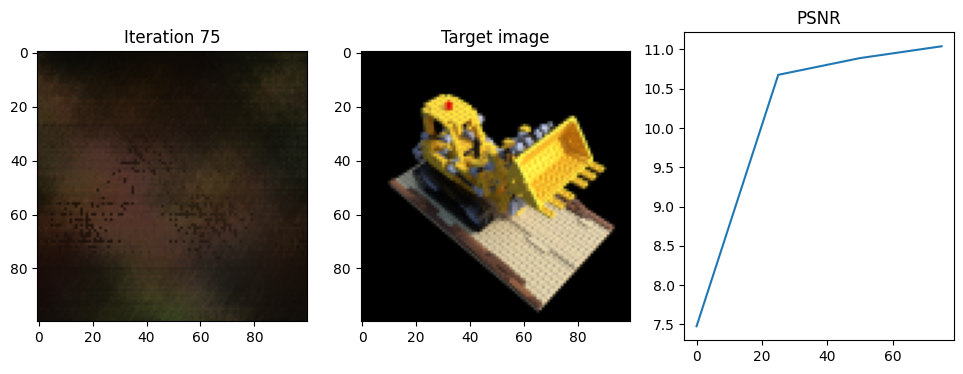

Iteration 100  Loss: 0.0228  PSNR: 12.65  Time: 1.03 secs per iter,  1.63 mins in total


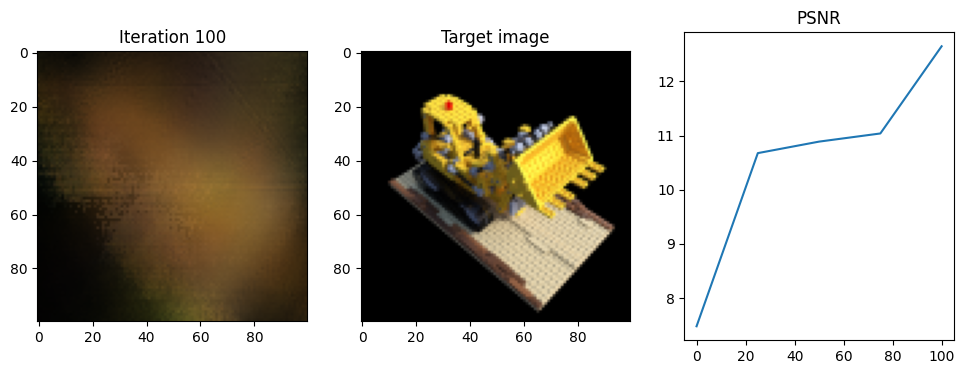

Iteration 125  Loss: 0.0502  PSNR: 14.47  Time: 0.93 secs per iter,  2.02 mins in total


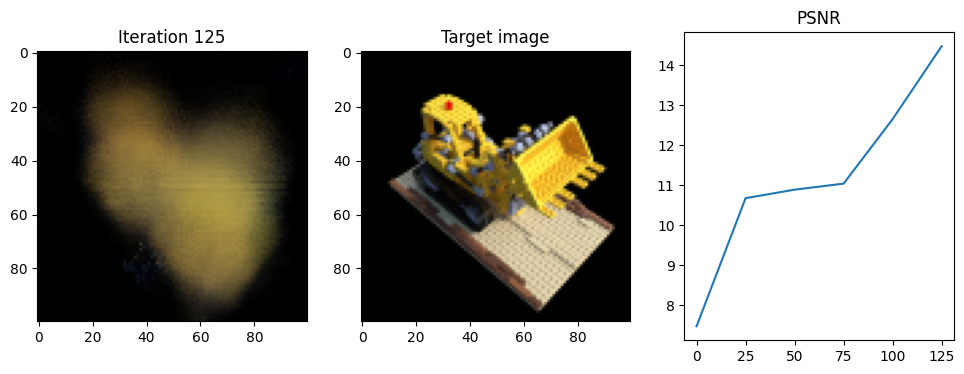

Iteration 150  Loss: 0.0286  PSNR: 14.40  Time: 0.92 secs per iter,  2.40 mins in total


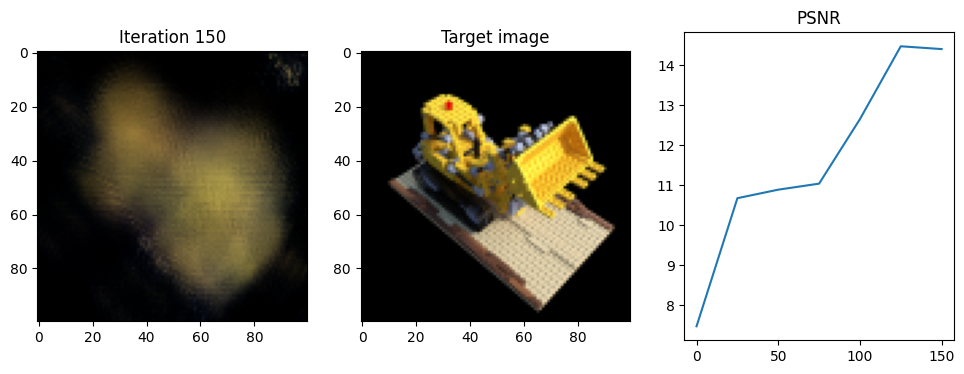

Iteration 175  Loss: 0.0199  PSNR: 15.74  Time: 0.91 secs per iter,  2.78 mins in total


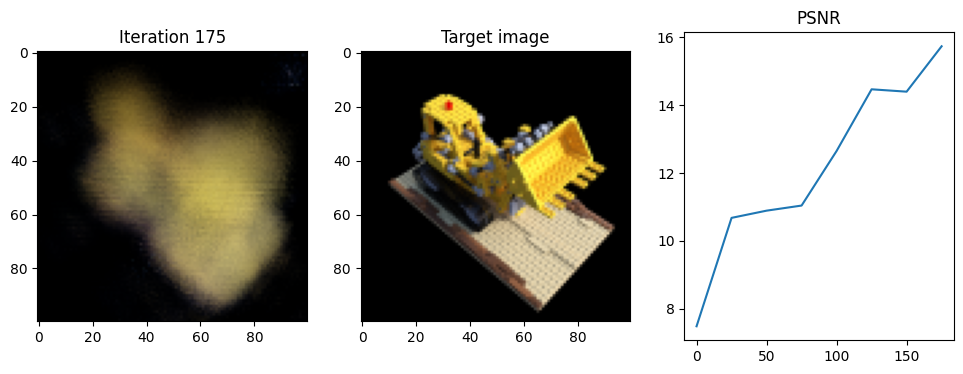

Iteration 200  Loss: 0.0306  PSNR: 15.50  Time: 0.91 secs per iter,  3.16 mins in total


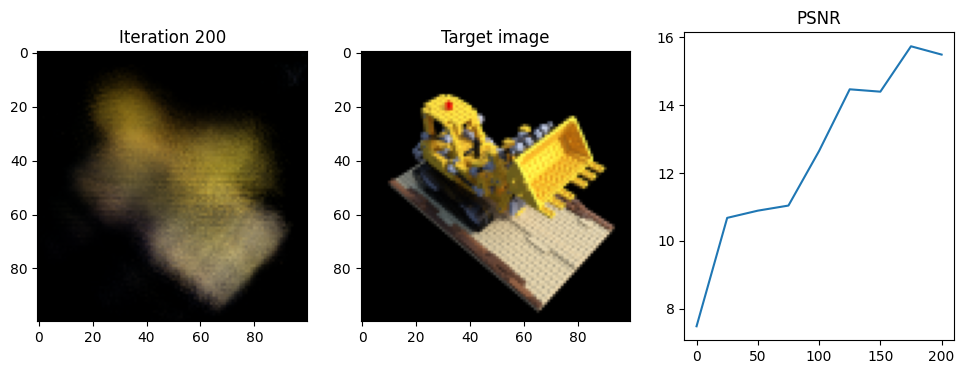

Iteration 225  Loss: 0.0302  PSNR: 16.75  Time: 0.92 secs per iter,  3.54 mins in total


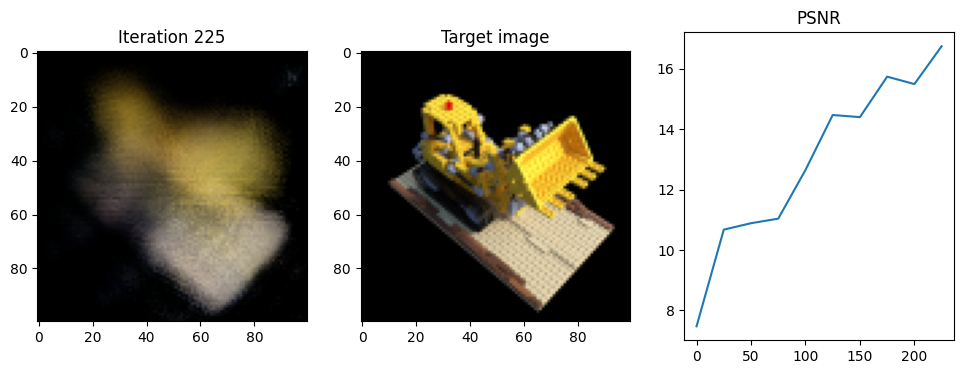

Iteration 250  Loss: 0.0169  PSNR: 17.59  Time: 0.91 secs per iter,  3.92 mins in total


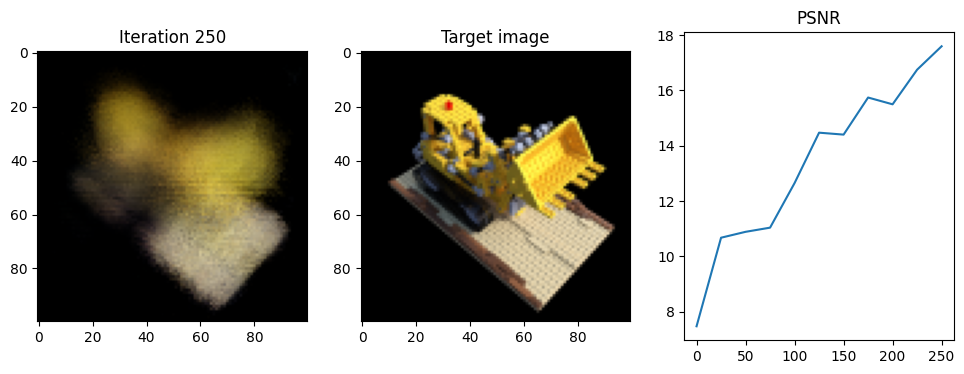

Iteration 275  Loss: 0.0229  PSNR: 18.24  Time: 0.91 secs per iter,  4.30 mins in total


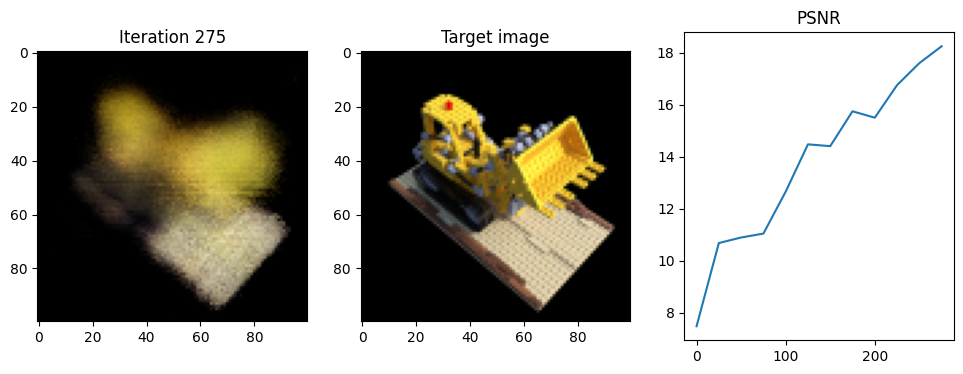

Iteration 300  Loss: 0.0139  PSNR: 17.79  Time: 0.92 secs per iter,  4.68 mins in total


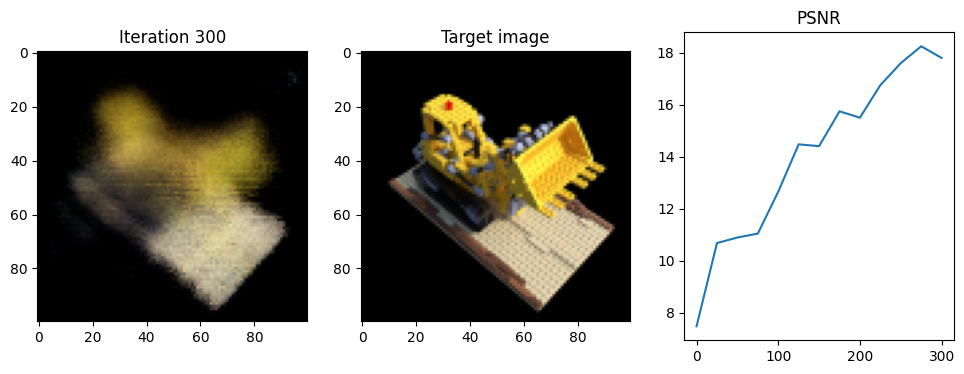

Iteration 325  Loss: 0.0126  PSNR: 18.42  Time: 0.91 secs per iter,  5.06 mins in total


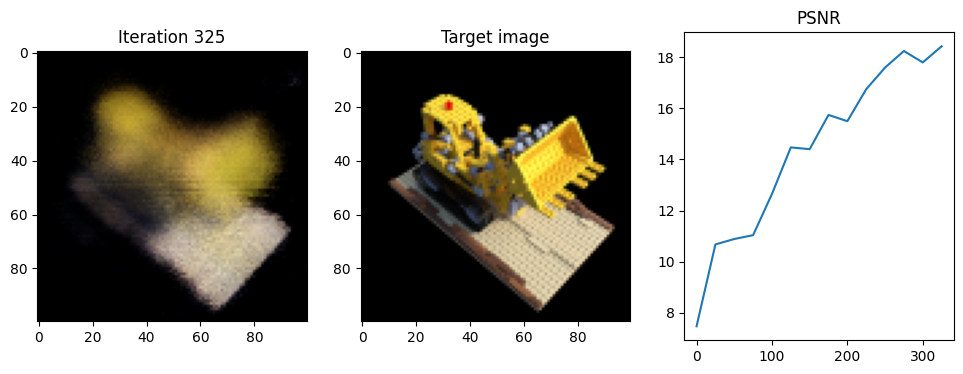

Iteration 350  Loss: 0.0080  PSNR: 18.93  Time: 0.90 secs per iter,  5.44 mins in total


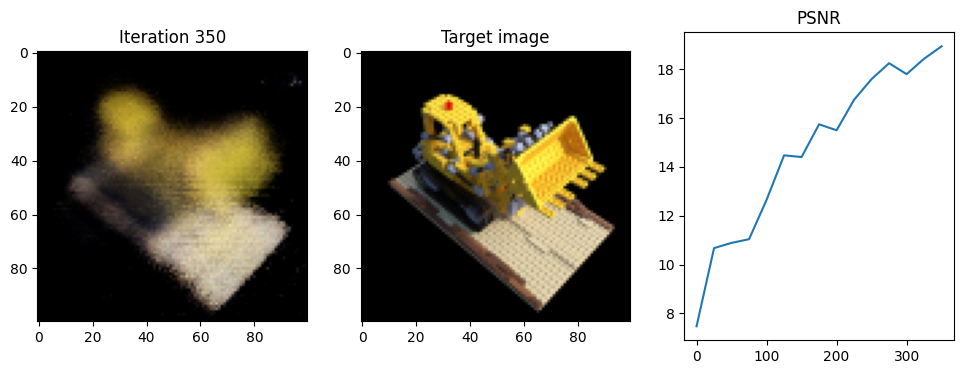

Iteration 375  Loss: 0.0108  PSNR: 19.13  Time: 0.90 secs per iter,  5.81 mins in total


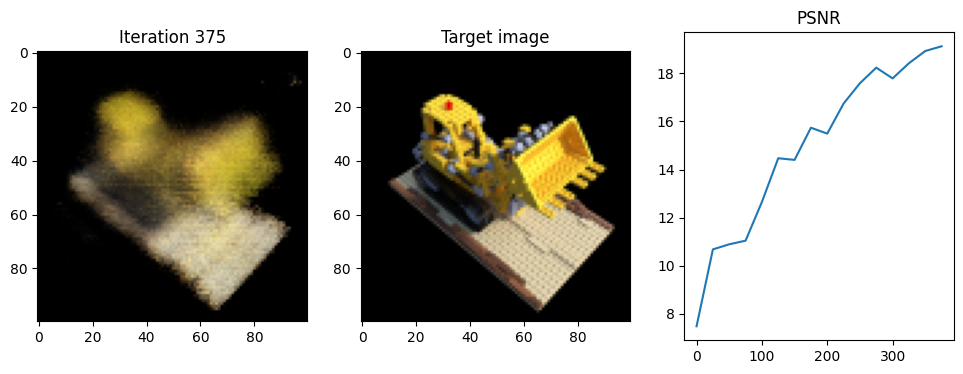

Iteration 400  Loss: 0.0100  PSNR: 19.36  Time: 0.90 secs per iter,  6.19 mins in total


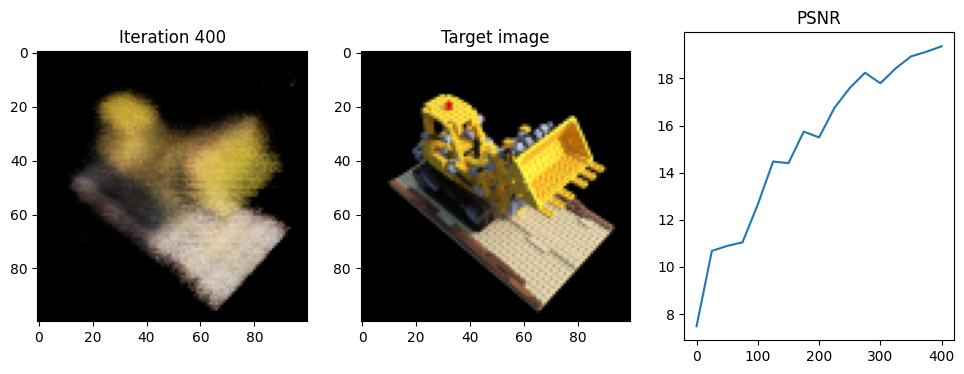

Iteration 425  Loss: 0.0101  PSNR: 19.21  Time: 0.90 secs per iter,  6.57 mins in total


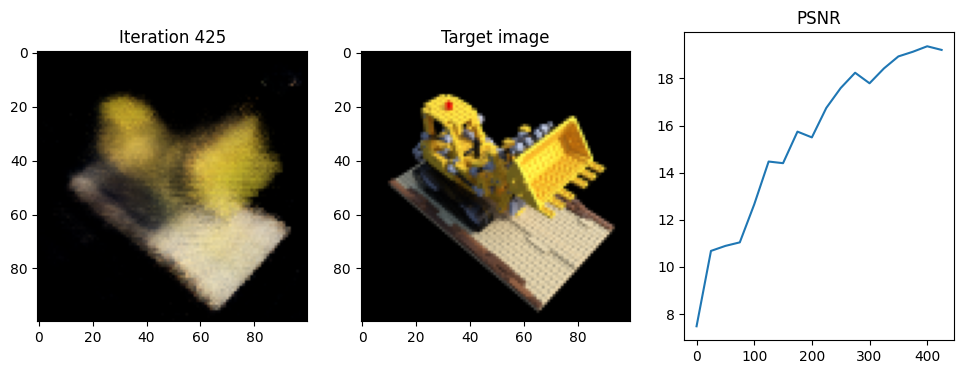

Iteration 450  Loss: 0.0050  PSNR: 19.43  Time: 0.90 secs per iter,  6.94 mins in total


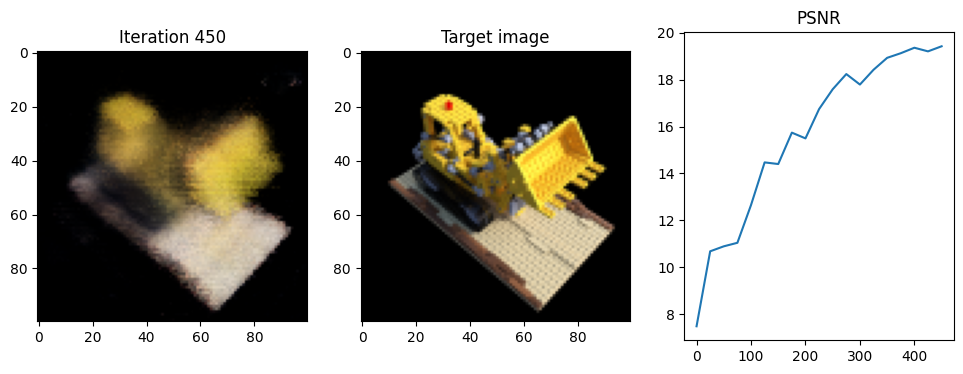

Iteration 475  Loss: 0.0067  PSNR: 18.84  Time: 0.90 secs per iter,  7.31 mins in total


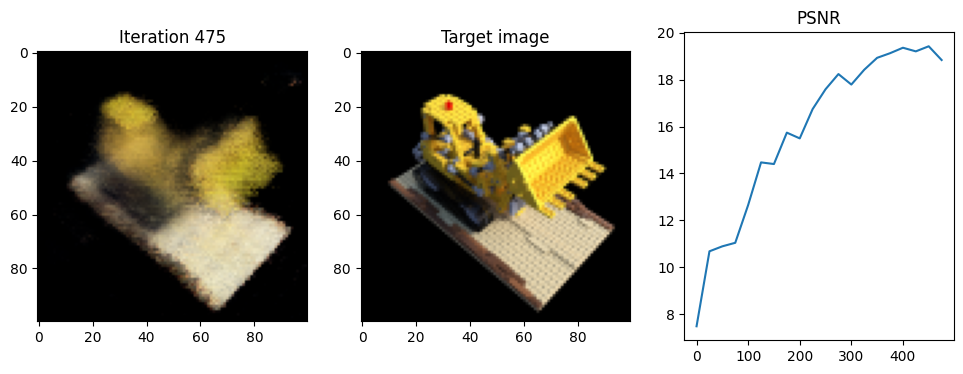

Iteration 500  Loss: 0.0070  PSNR: 19.74  Time: 0.91 secs per iter,  7.69 mins in total


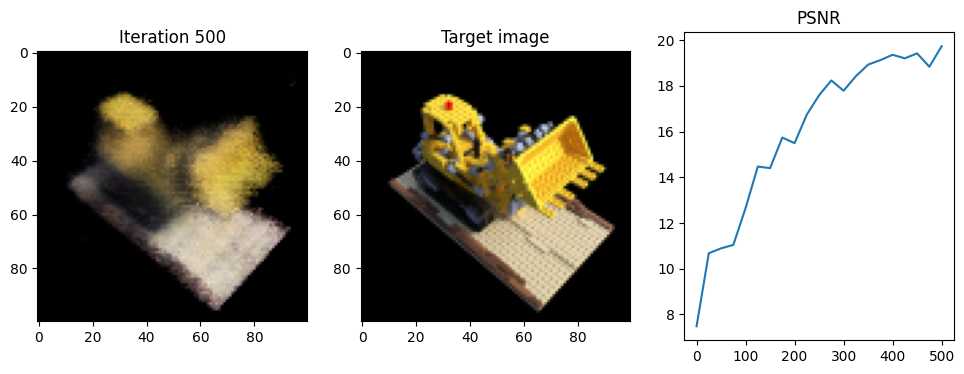

Iteration 525  Loss: 0.0124  PSNR: 19.77  Time: 0.91 secs per iter,  8.07 mins in total


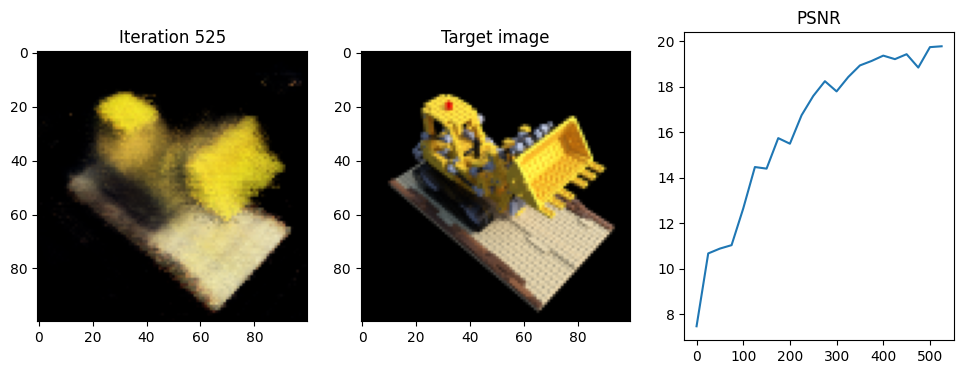

Iteration 550  Loss: 0.0082  PSNR: 19.75  Time: 0.90 secs per iter,  8.44 mins in total


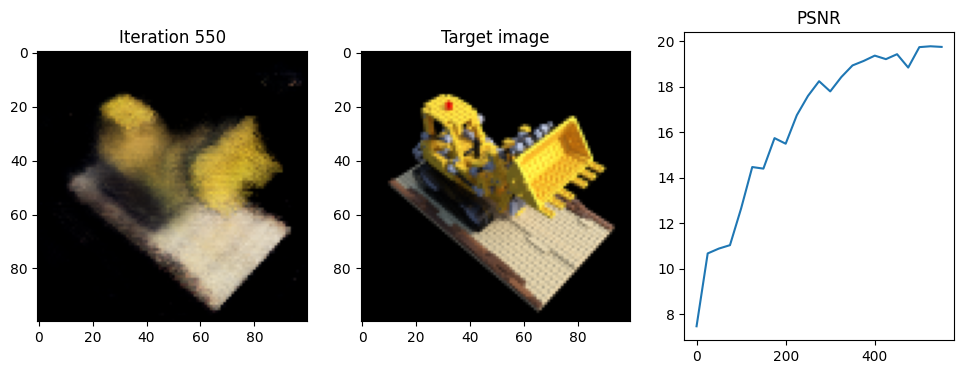

Iteration 575  Loss: 0.0048  PSNR: 20.52  Time: 0.89 secs per iter,  8.81 mins in total


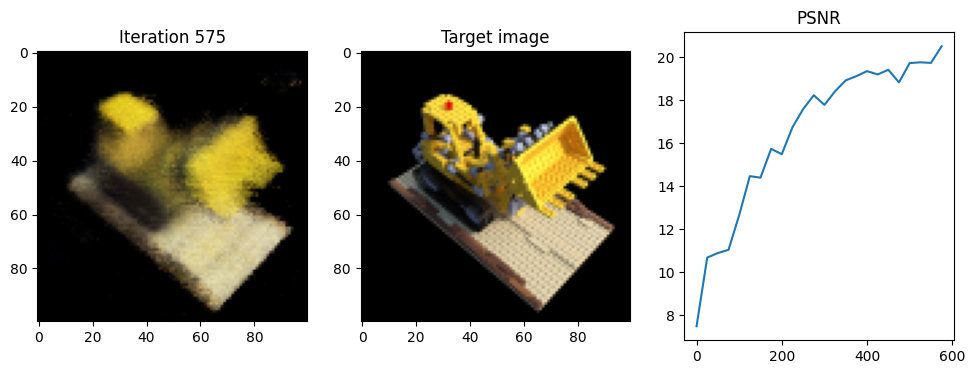

Iteration 600  Loss: 0.0040  PSNR: 20.52  Time: 0.90 secs per iter,  9.19 mins in total


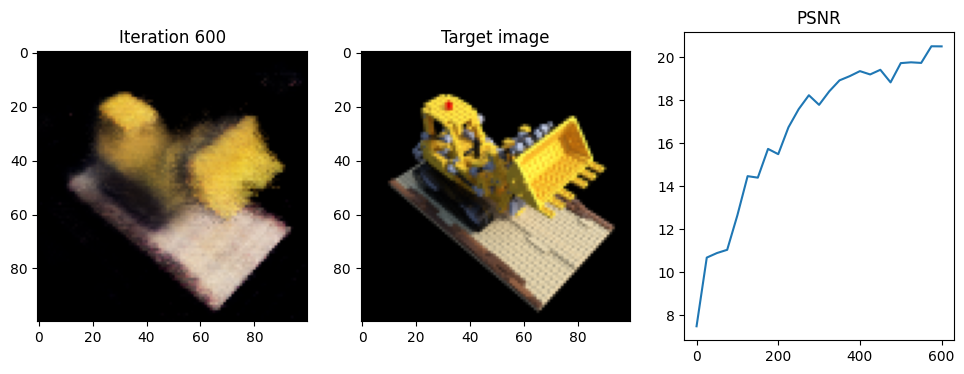

Iteration 625  Loss: 0.0049  PSNR: 20.07  Time: 0.89 secs per iter,  9.56 mins in total


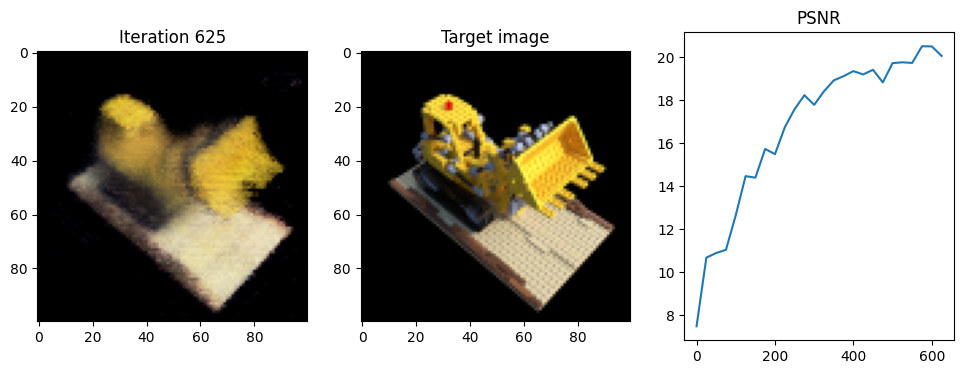

Iteration 650  Loss: 0.0075  PSNR: 20.38  Time: 0.89 secs per iter,  9.93 mins in total


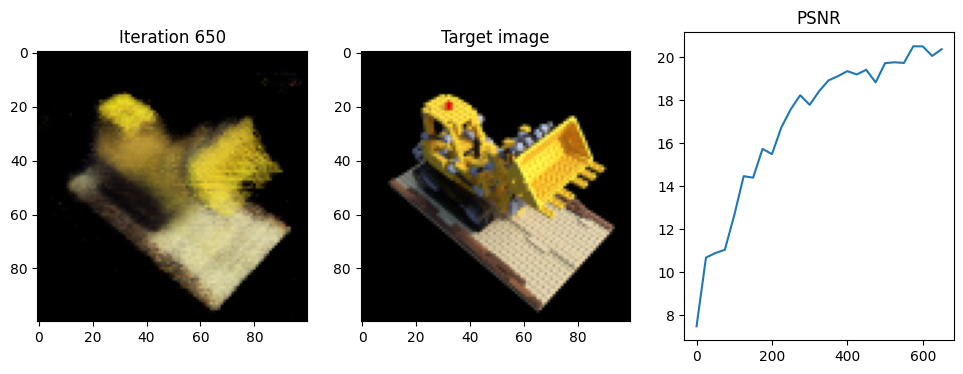

Iteration 675  Loss: 0.0095  PSNR: 20.50  Time: 0.90 secs per iter,  10.31 mins in total


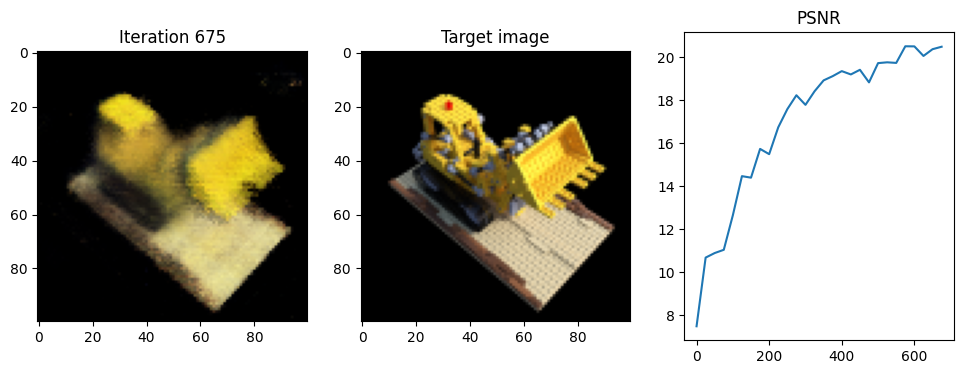

Iteration 700  Loss: 0.0050  PSNR: 20.38  Time: 0.89 secs per iter,  10.68 mins in total


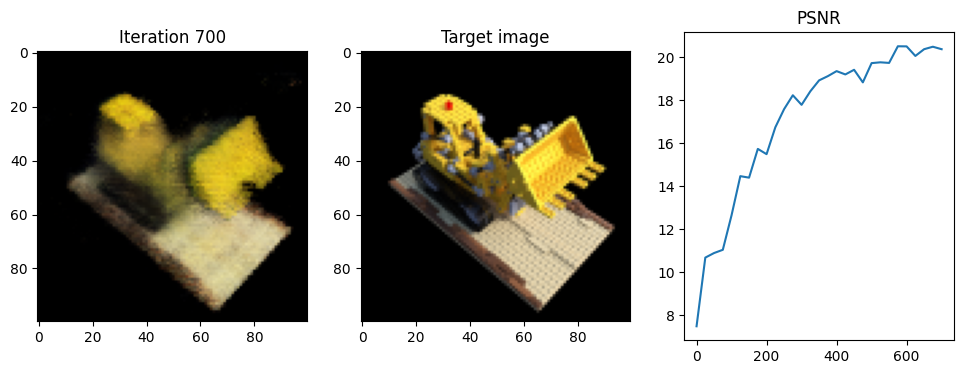

Iteration 725  Loss: 0.0082  PSNR: 20.11  Time: 0.89 secs per iter,  11.05 mins in total


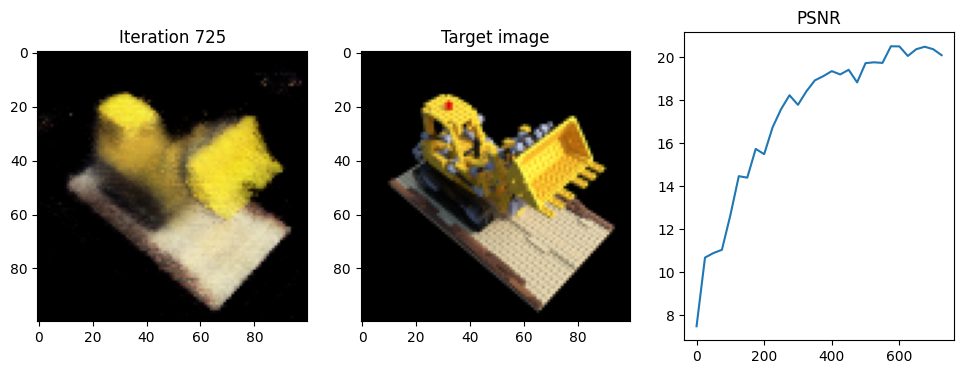

Iteration 750  Loss: 0.0085  PSNR: 21.26  Time: 0.89 secs per iter,  11.42 mins in total


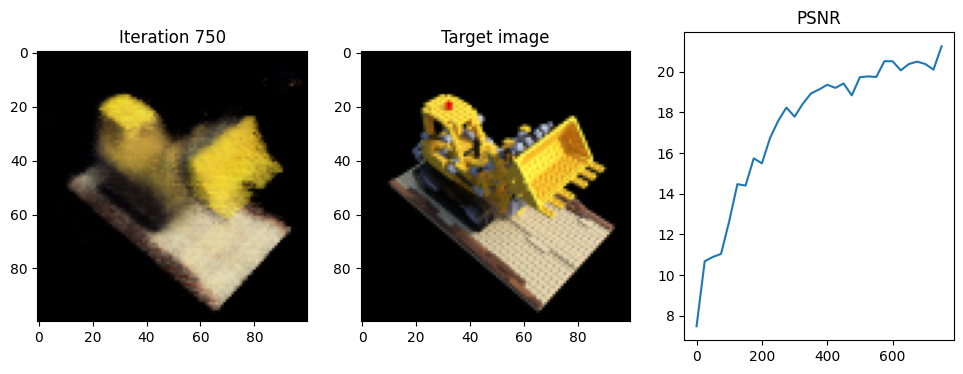

Iteration 775  Loss: 0.0083  PSNR: 21.14  Time: 0.90 secs per iter,  11.79 mins in total


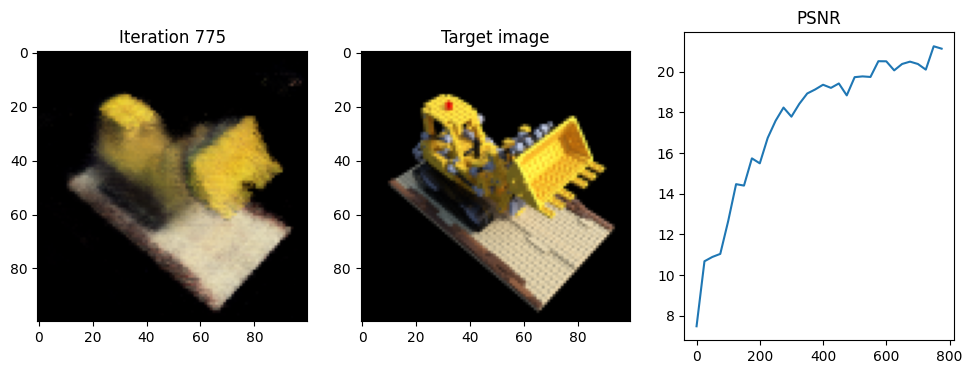

Iteration 800  Loss: 0.0087  PSNR: 21.19  Time: 0.89 secs per iter,  12.16 mins in total


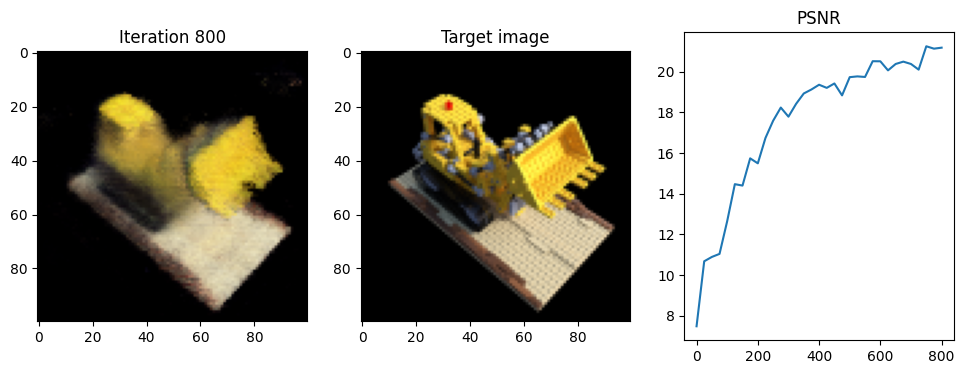

Iteration 825  Loss: 0.0047  PSNR: 21.04  Time: 0.89 secs per iter,  12.53 mins in total


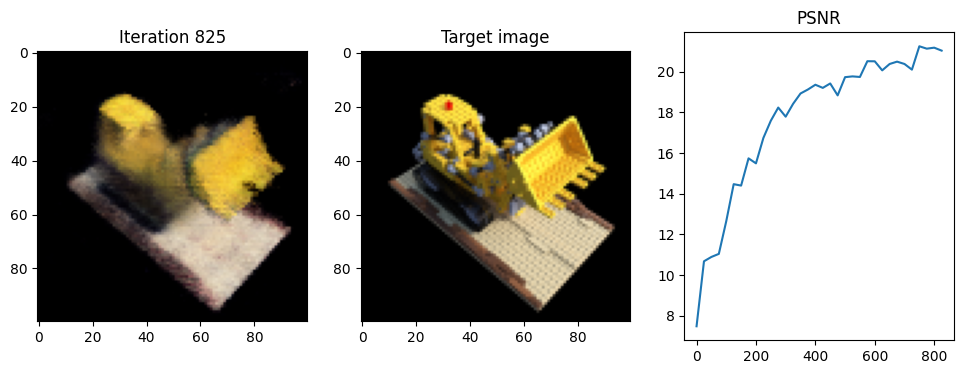

Iteration 850  Loss: 0.0076  PSNR: 21.18  Time: 0.90 secs per iter,  12.91 mins in total


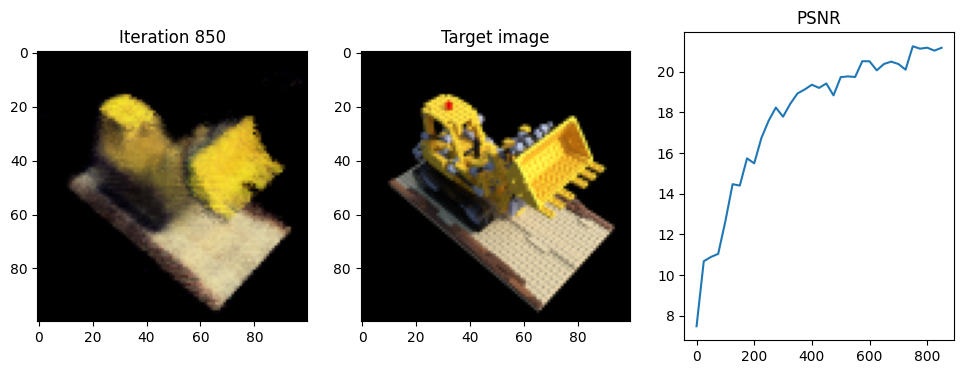

Iteration 875  Loss: 0.0072  PSNR: 21.27  Time: 0.89 secs per iter,  13.28 mins in total


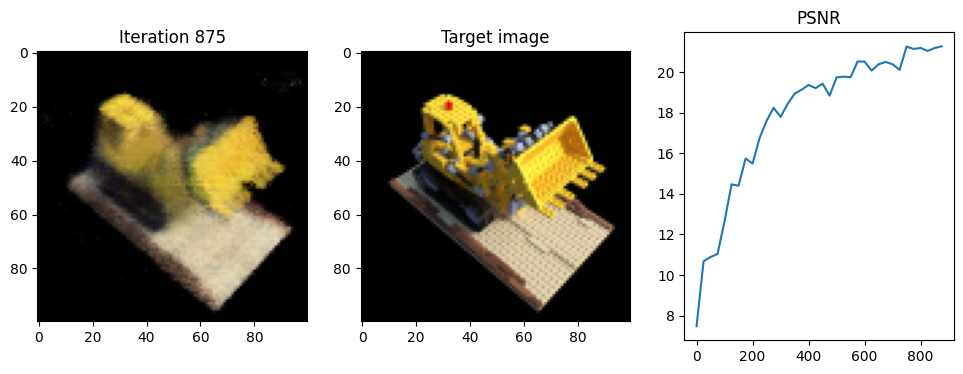

Iteration 900  Loss: 0.0038  PSNR: 20.99  Time: 0.89 secs per iter,  13.65 mins in total


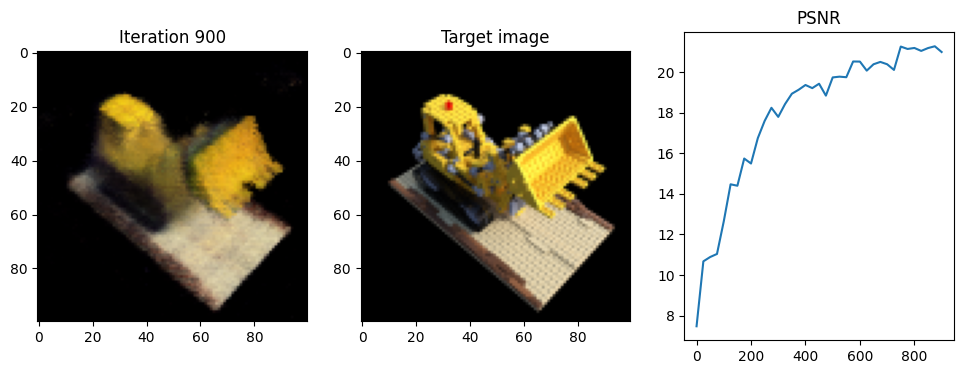

Iteration 925  Loss: 0.0047  PSNR: 21.60  Time: 0.89 secs per iter,  14.02 mins in total


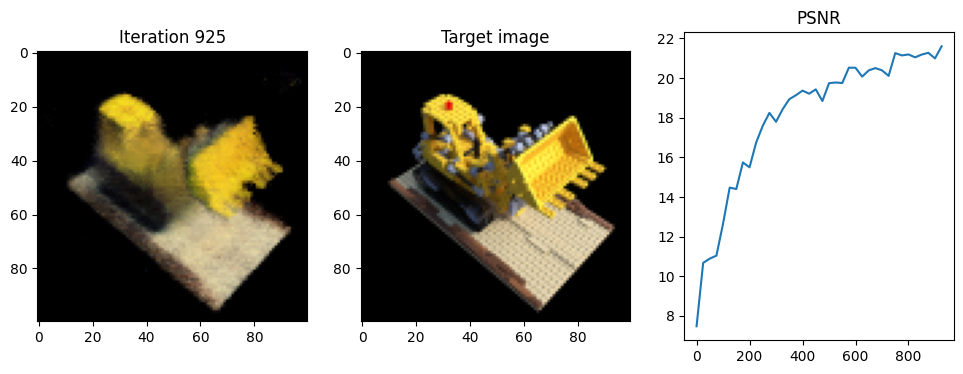

Iteration 950  Loss: 0.0049  PSNR: 21.81  Time: 0.89 secs per iter,  14.39 mins in total


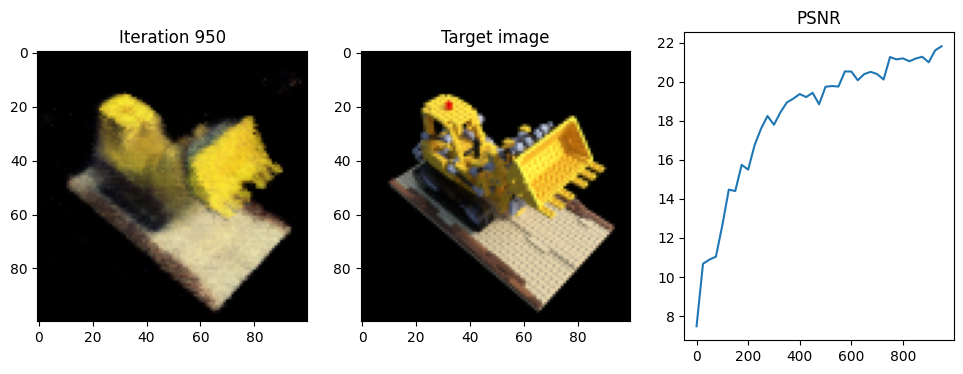

Iteration 975  Loss: 0.0037  PSNR: 21.97  Time: 0.89 secs per iter,  14.76 mins in total


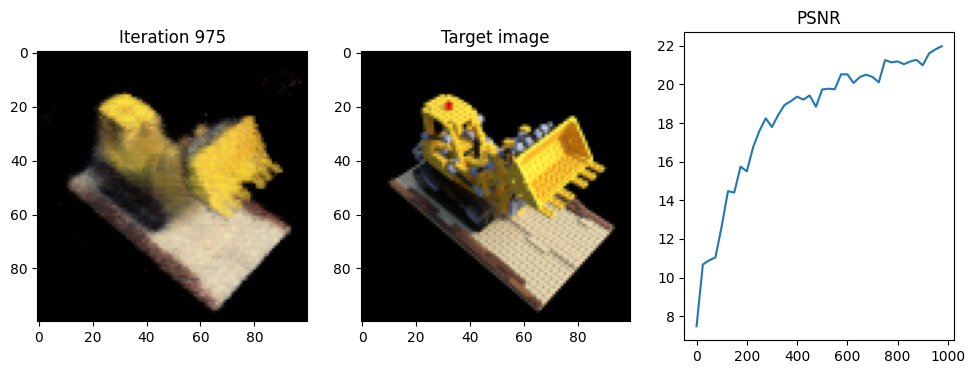

Iteration 1000  Loss: 0.0042  PSNR: 22.37  Time: 0.89 secs per iter,  15.13 mins in total


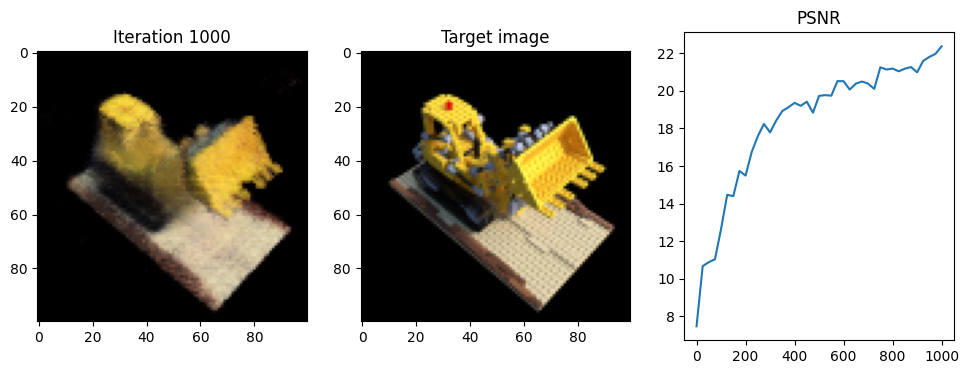

Iteration 1025  Loss: 0.0072  PSNR: 22.23  Time: 0.91 secs per iter,  15.51 mins in total


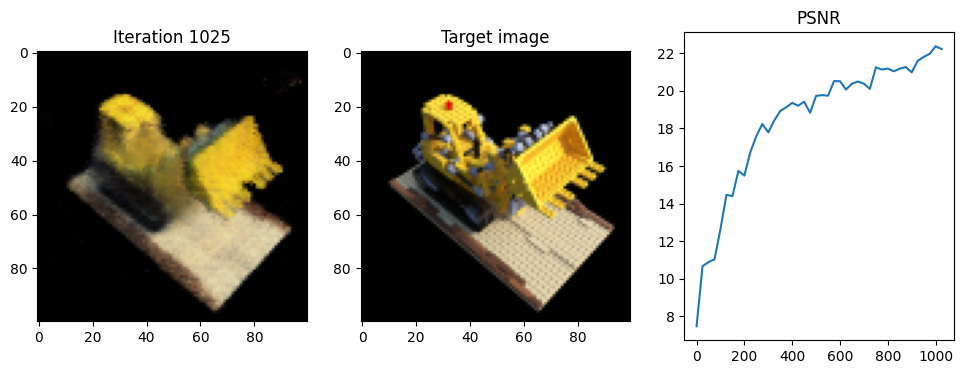

Iteration 1050  Loss: 0.0066  PSNR: 21.76  Time: 0.89 secs per iter,  15.88 mins in total


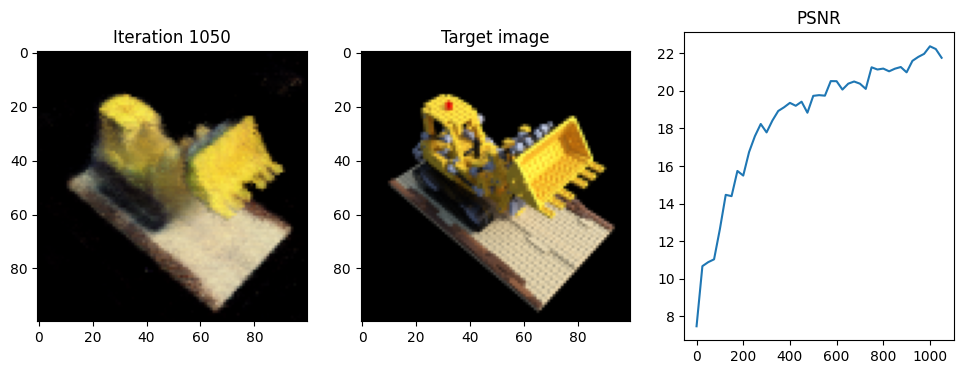

Iteration 1075  Loss: 0.0032  PSNR: 20.89  Time: 0.89 secs per iter,  16.25 mins in total


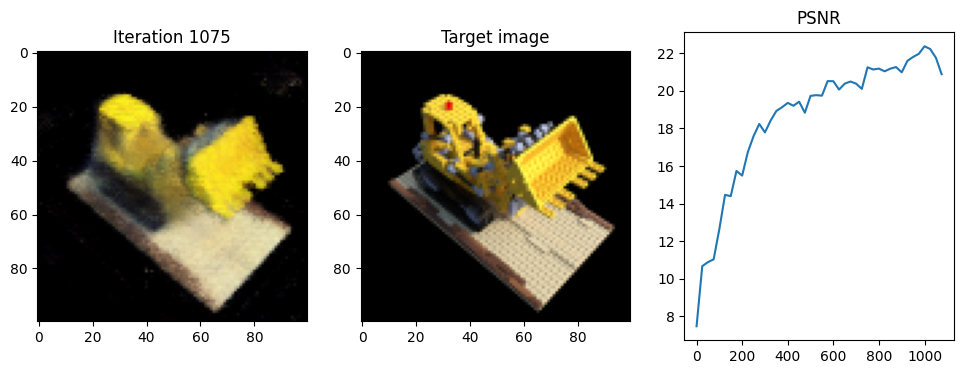

Iteration 1100  Loss: 0.0081  PSNR: 22.04  Time: 0.89 secs per iter,  16.62 mins in total


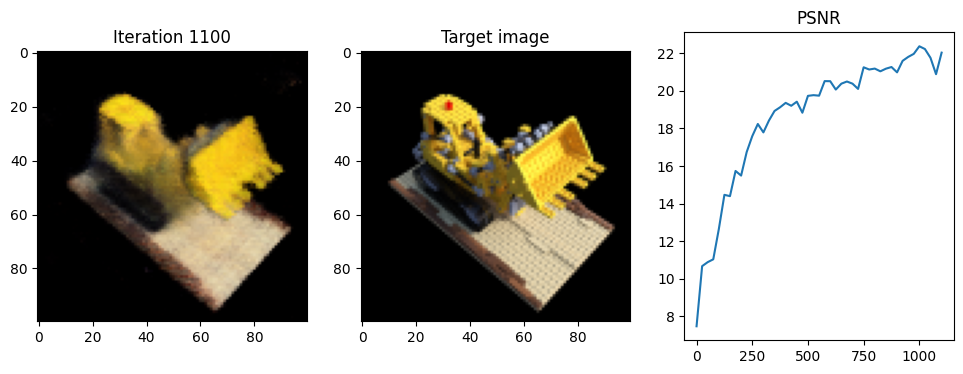

Iteration 1125  Loss: 0.0034  PSNR: 22.09  Time: 0.89 secs per iter,  16.99 mins in total


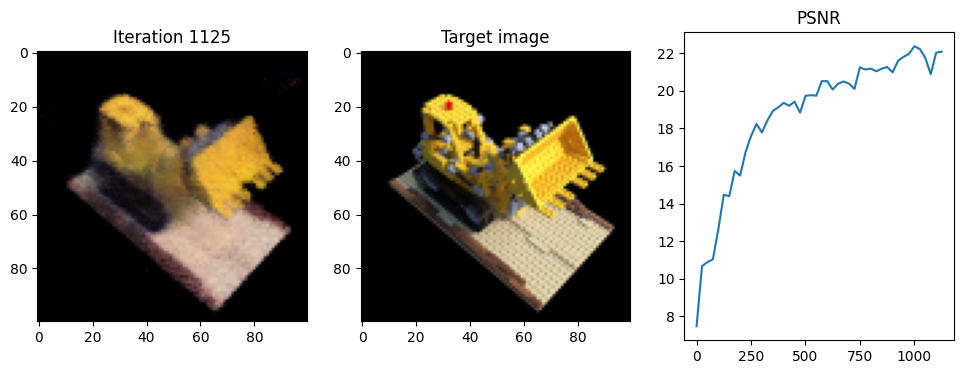

Iteration 1150  Loss: 0.0060  PSNR: 22.23  Time: 0.89 secs per iter,  17.36 mins in total


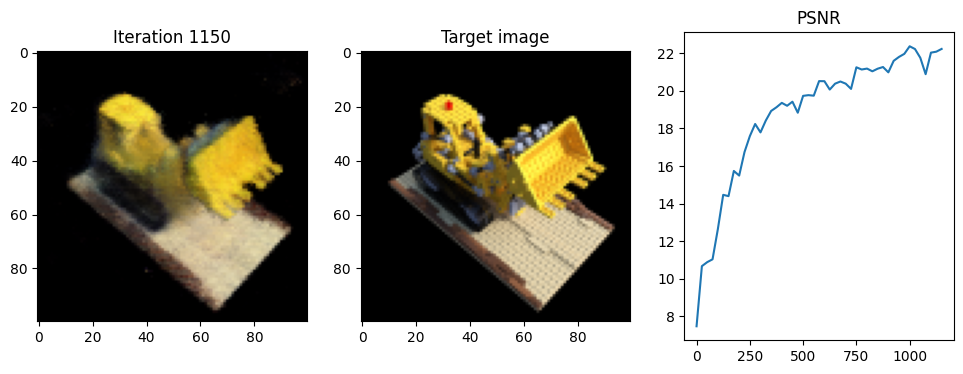

Iteration 1175  Loss: 0.0060  PSNR: 22.22  Time: 0.89 secs per iter,  17.73 mins in total


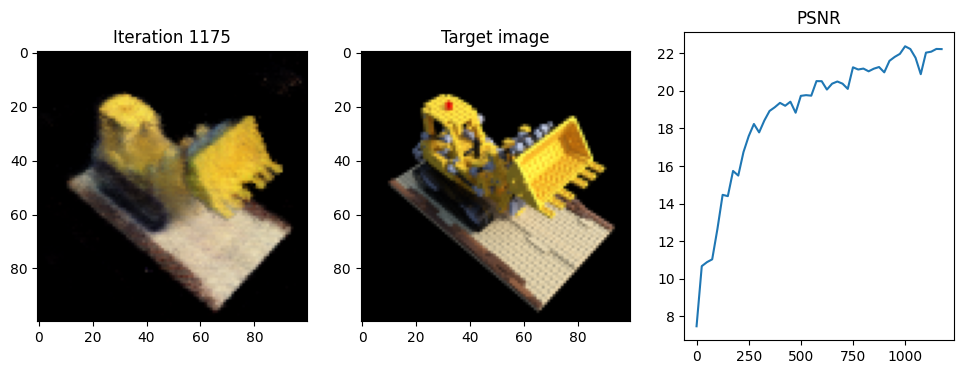

Iteration 1200  Loss: 0.0061  PSNR: 22.09  Time: 0.89 secs per iter,  18.10 mins in total


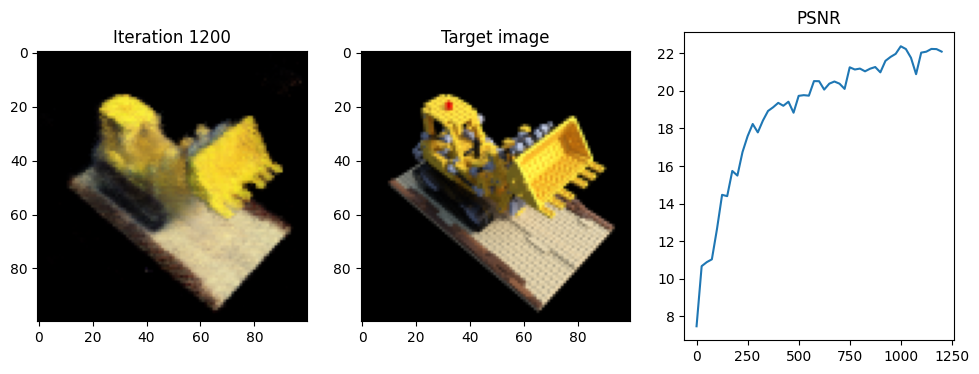

Iteration 1225  Loss: 0.0063  PSNR: 22.23  Time: 0.89 secs per iter,  18.47 mins in total


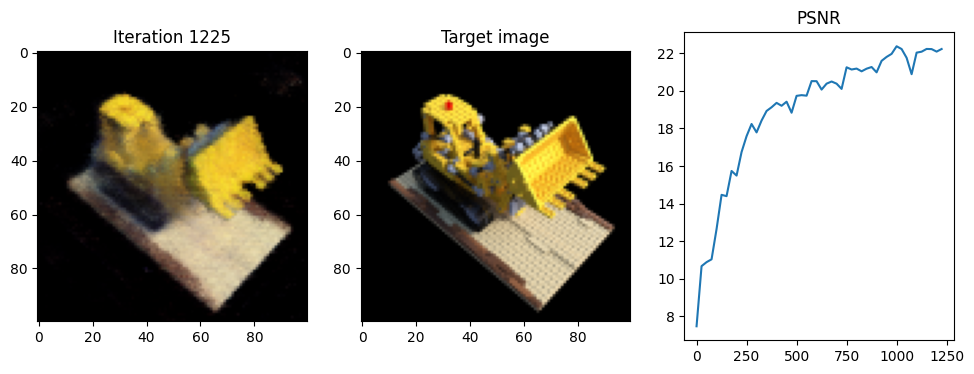

Iteration 1250  Loss: 0.0060  PSNR: 22.35  Time: 0.90 secs per iter,  18.85 mins in total


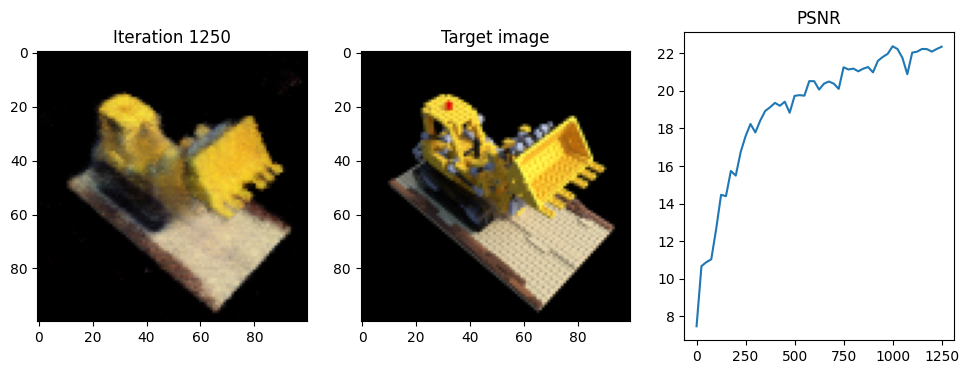

Iteration 1275  Loss: 0.0035  PSNR: 21.78  Time: 0.89 secs per iter,  19.22 mins in total


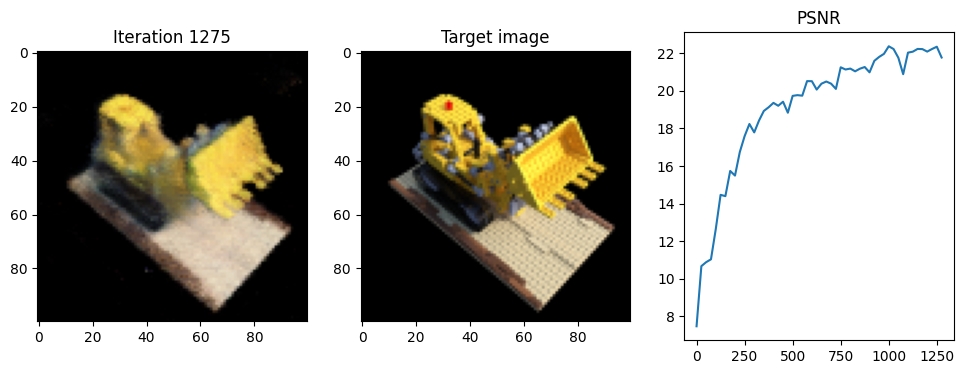

Iteration 1300  Loss: 0.0059  PSNR: 22.45  Time: 0.89 secs per iter,  19.59 mins in total


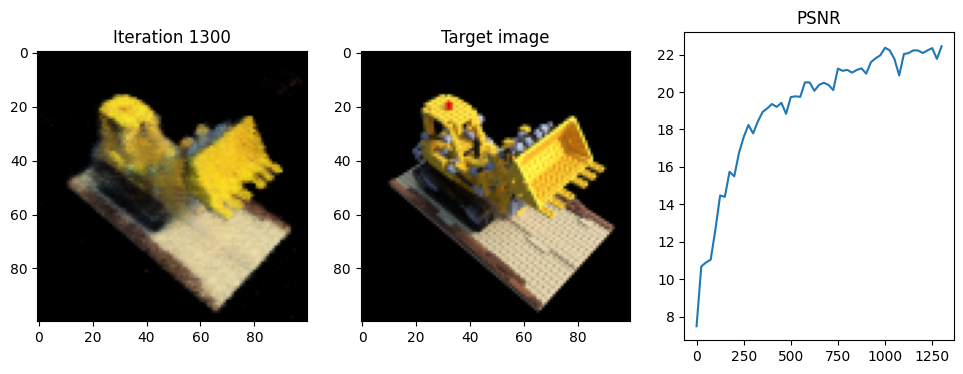

Iteration 1325  Loss: 0.0039  PSNR: 21.98  Time: 0.89 secs per iter,  19.96 mins in total


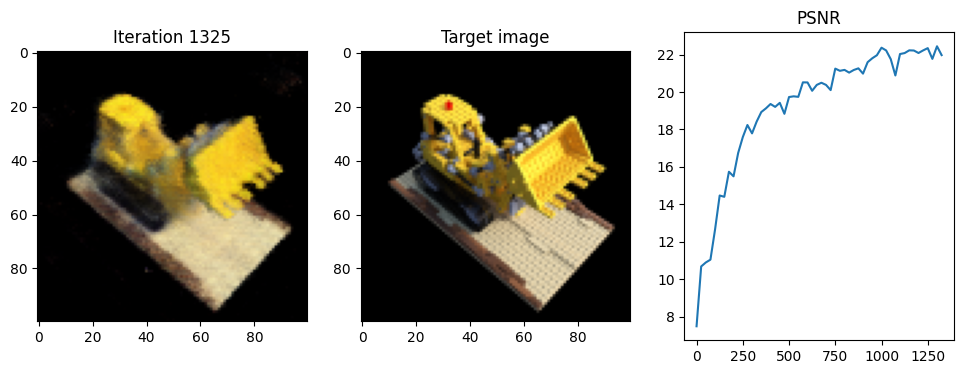

Iteration 1350  Loss: 0.0051  PSNR: 22.47  Time: 0.89 secs per iter,  20.33 mins in total


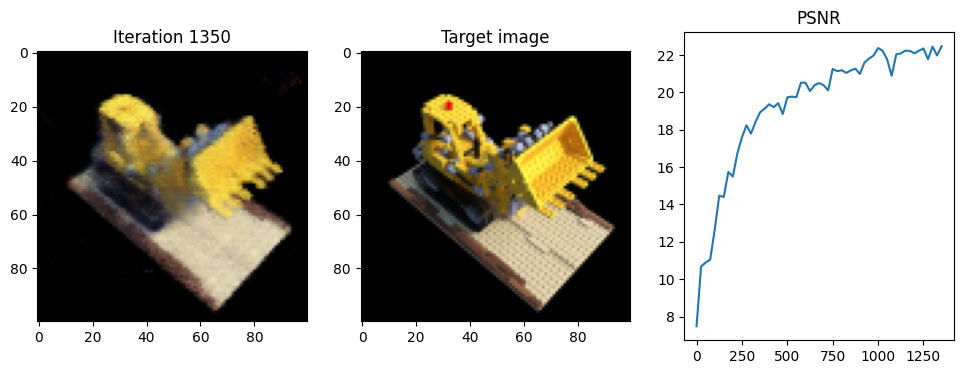

Iteration 1375  Loss: 0.0053  PSNR: 22.44  Time: 0.89 secs per iter,  20.70 mins in total


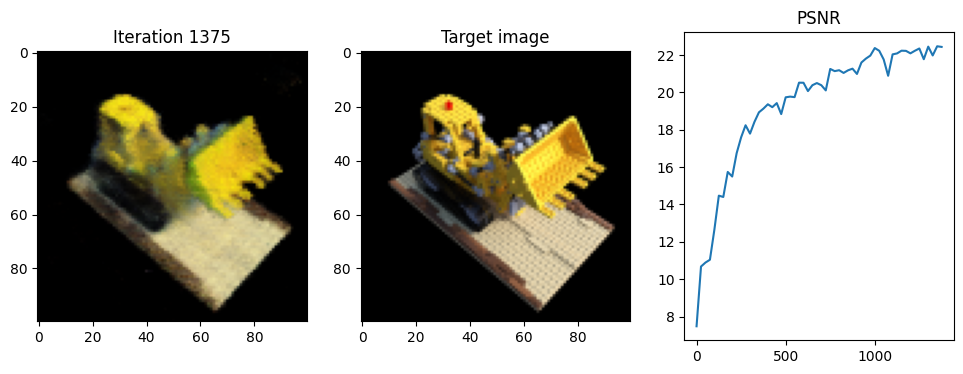

Iteration 1400  Loss: 0.0049  PSNR: 22.83  Time: 0.89 secs per iter,  21.07 mins in total


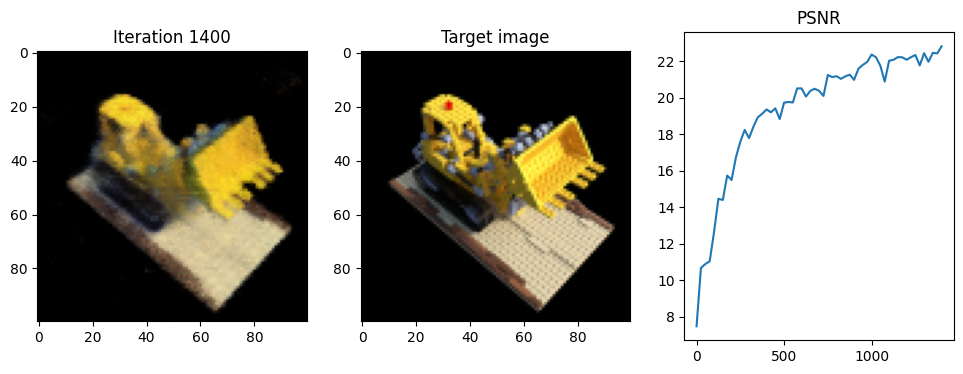

Iteration 1425  Loss: 0.0067  PSNR: 22.63  Time: 0.89 secs per iter,  21.44 mins in total


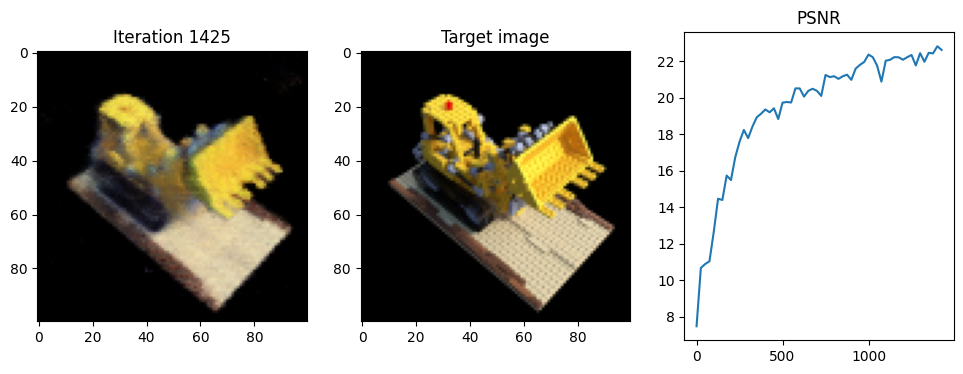

Iteration 1450  Loss: 0.0048  PSNR: 22.20  Time: 0.90 secs per iter,  21.81 mins in total


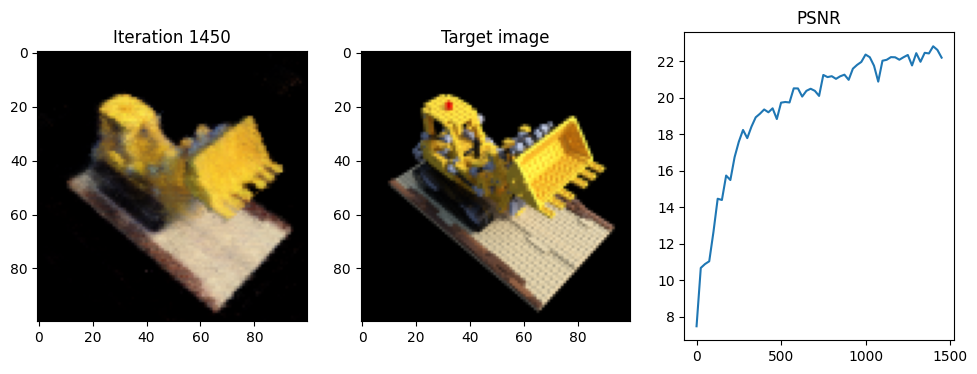

Iteration 1475  Loss: 0.0033  PSNR: 22.85  Time: 0.89 secs per iter,  22.18 mins in total


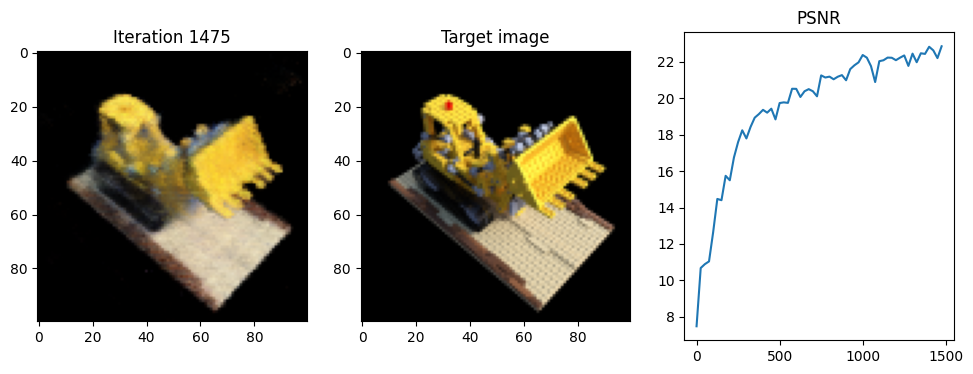

Iteration 1500  Loss: 0.0032  PSNR: 22.78  Time: 0.90 secs per iter,  22.56 mins in total


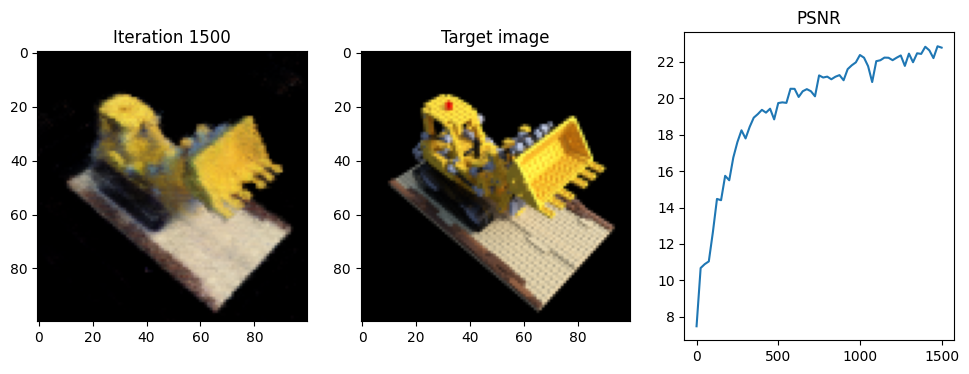

Iteration 1525  Loss: 0.0040  PSNR: 22.99  Time: 0.89 secs per iter,  22.93 mins in total


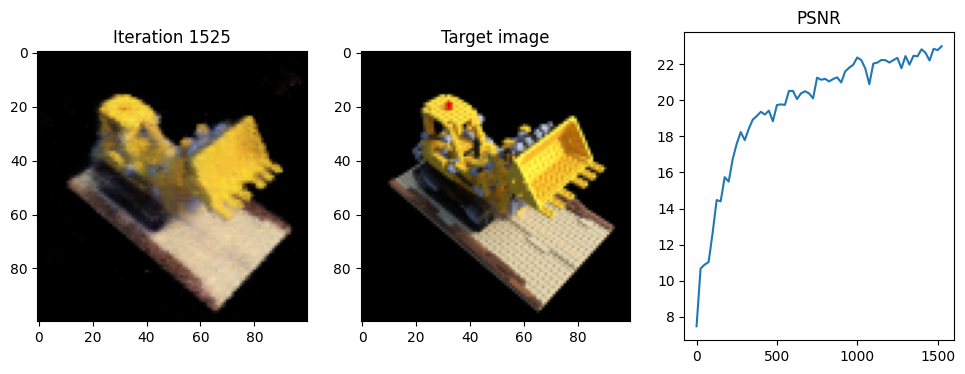

Iteration 1550  Loss: 0.0054  PSNR: 23.44  Time: 0.89 secs per iter,  23.30 mins in total


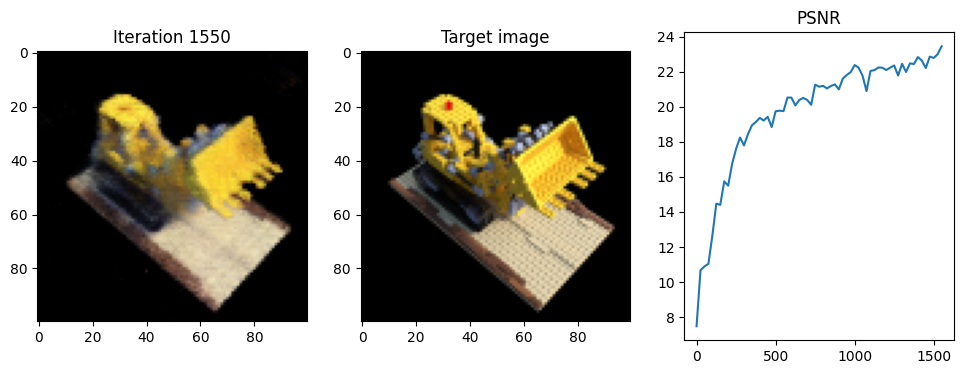

Iteration 1575  Loss: 0.0031  PSNR: 22.92  Time: 0.89 secs per iter,  23.67 mins in total


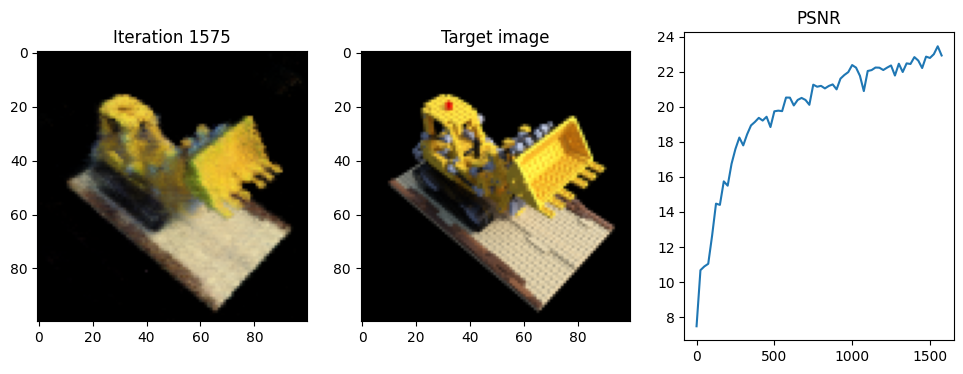

Iteration 1600  Loss: 0.0060  PSNR: 23.06  Time: 0.89 secs per iter,  24.04 mins in total


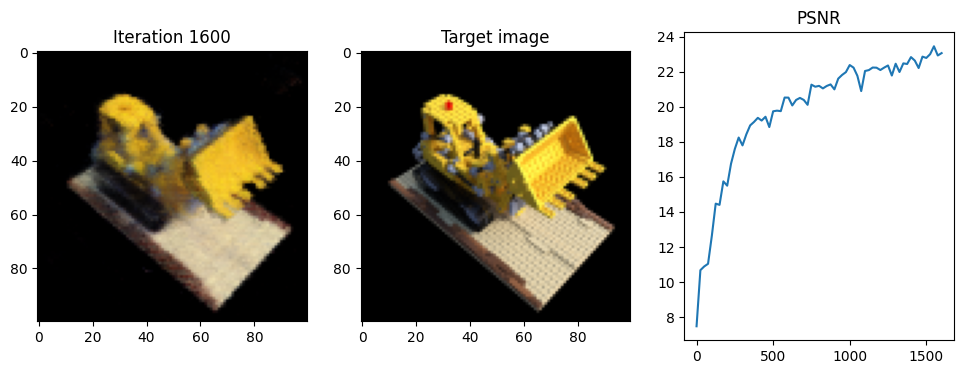

Iteration 1625  Loss: 0.0033  PSNR: 23.54  Time: 0.89 secs per iter,  24.41 mins in total


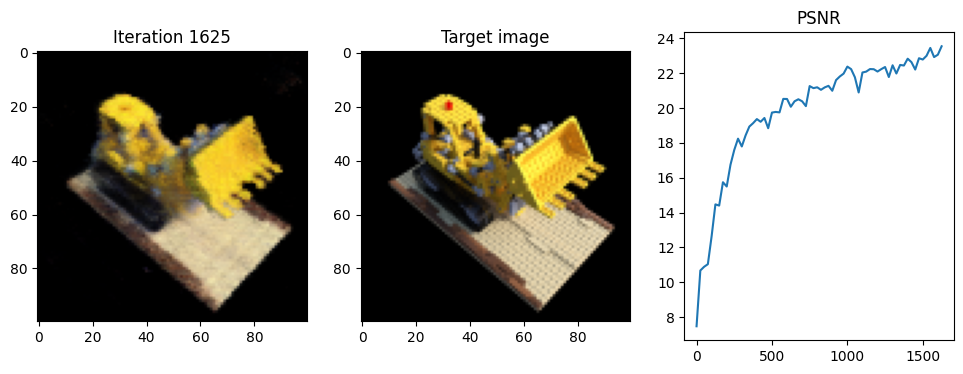

Iteration 1650  Loss: 0.0043  PSNR: 23.38  Time: 0.89 secs per iter,  24.78 mins in total


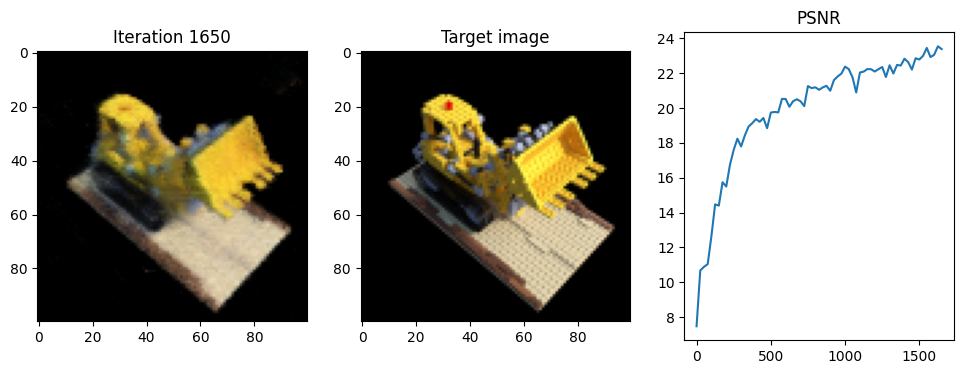

Iteration 1675  Loss: 0.0033  PSNR: 23.31  Time: 0.89 secs per iter,  25.15 mins in total


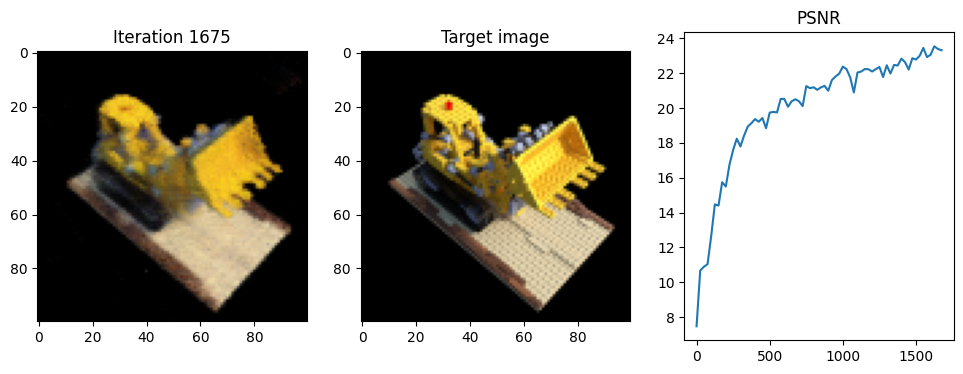

Iteration 1700  Loss: 0.0032  PSNR: 22.75  Time: 0.90 secs per iter,  25.52 mins in total


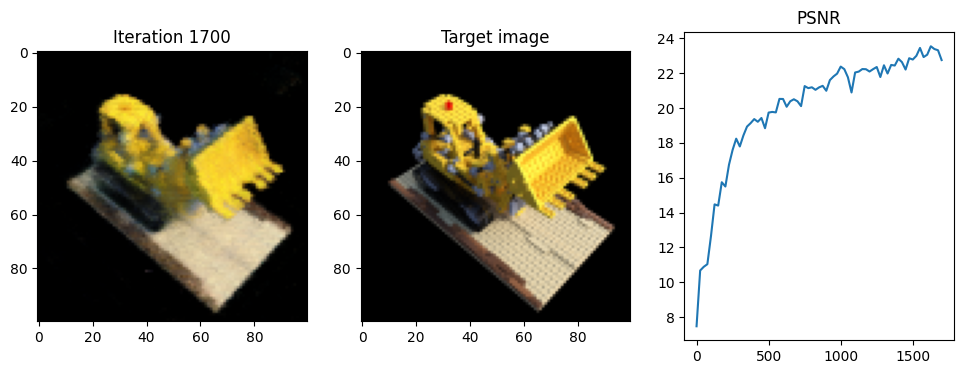

Iteration 1725  Loss: 0.0048  PSNR: 23.23  Time: 0.89 secs per iter,  25.90 mins in total


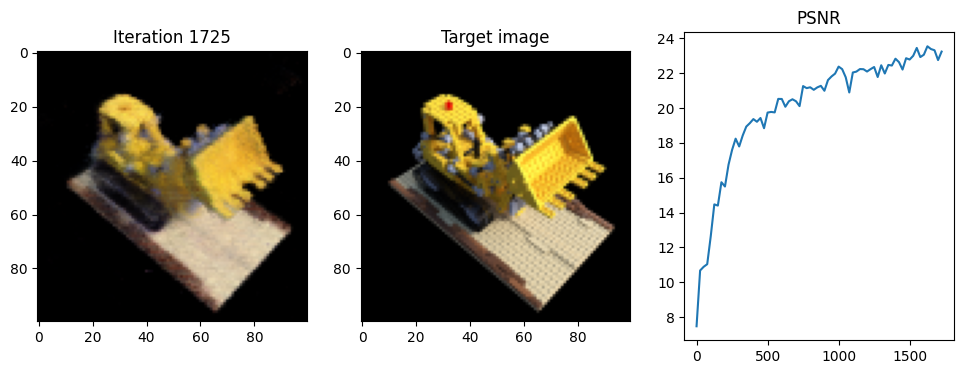

Iteration 1750  Loss: 0.0048  PSNR: 23.04  Time: 0.90 secs per iter,  26.27 mins in total


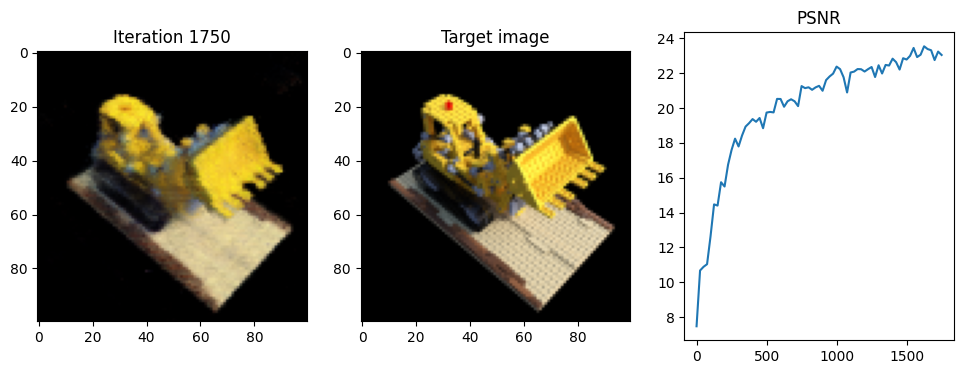

Iteration 1775  Loss: 0.0030  PSNR: 23.27  Time: 0.90 secs per iter,  26.64 mins in total


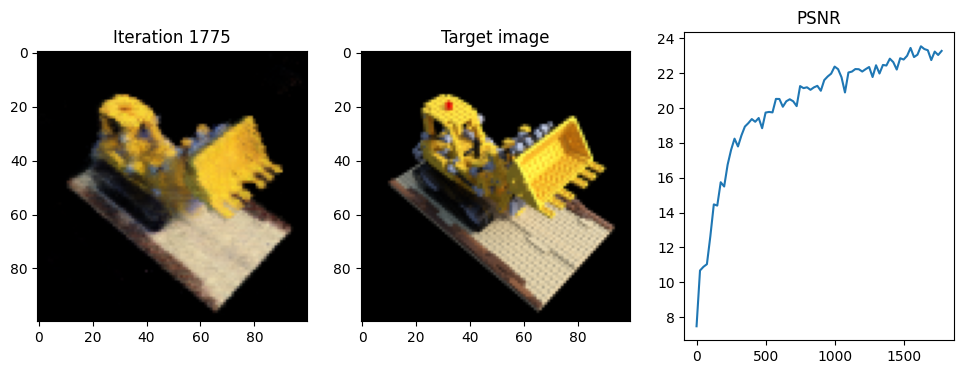

Iteration 1800  Loss: 0.0051  PSNR: 23.71  Time: 0.89 secs per iter,  27.02 mins in total


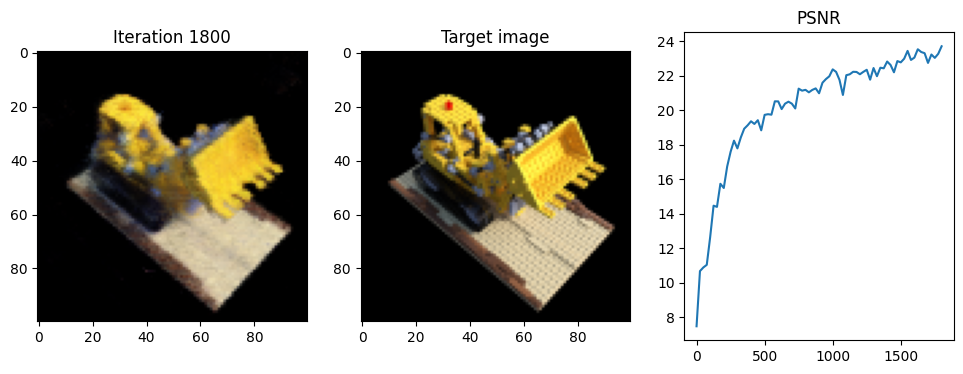

Iteration 1825  Loss: 0.0043  PSNR: 22.83  Time: 0.89 secs per iter,  27.39 mins in total


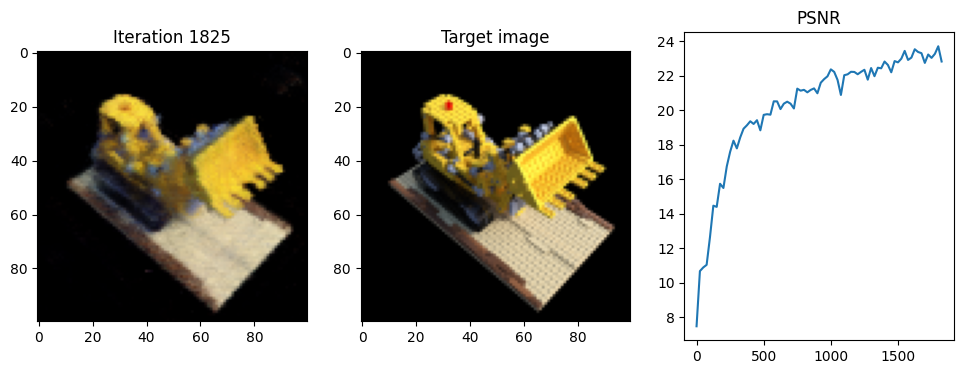

Iteration 1850  Loss: 0.0023  PSNR: 23.49  Time: 0.89 secs per iter,  27.76 mins in total


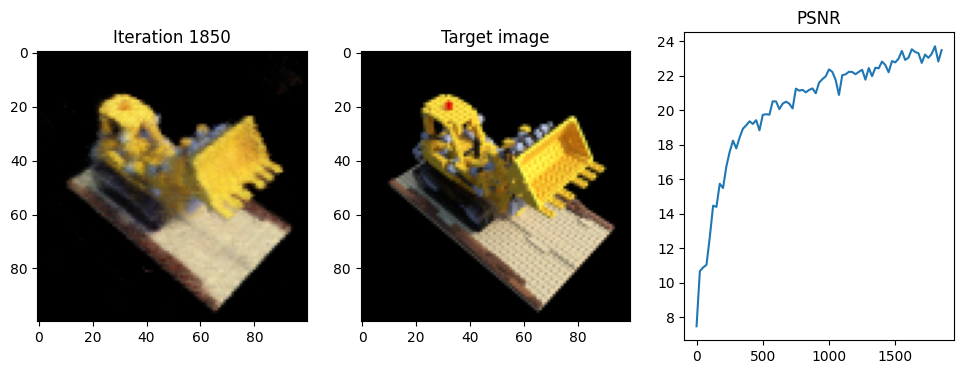

Iteration 1875  Loss: 0.0028  PSNR: 23.52  Time: 0.89 secs per iter,  28.13 mins in total


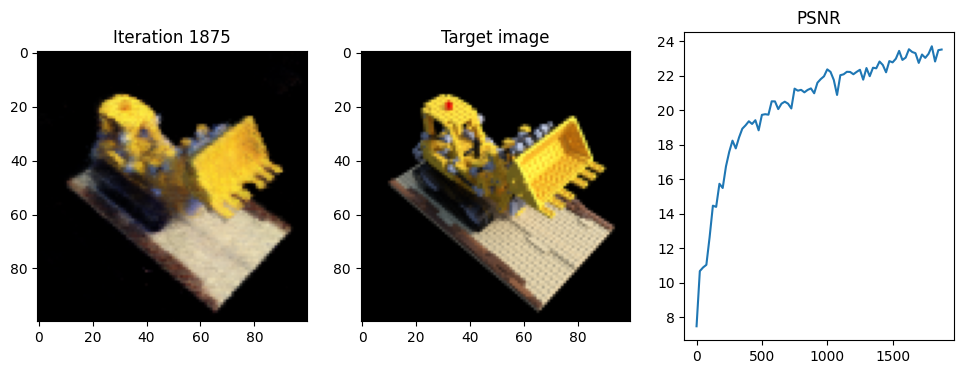

Iteration 1900  Loss: 0.0039  PSNR: 23.21  Time: 0.89 secs per iter,  28.50 mins in total


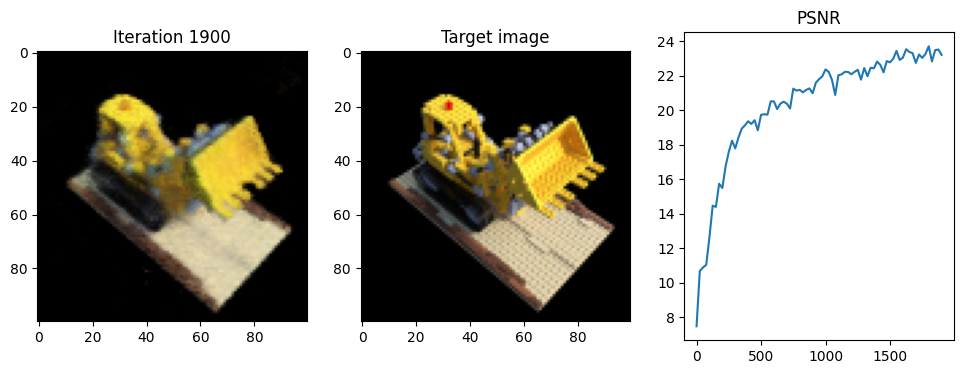

Iteration 1925  Loss: 0.0033  PSNR: 23.06  Time: 0.89 secs per iter,  28.87 mins in total


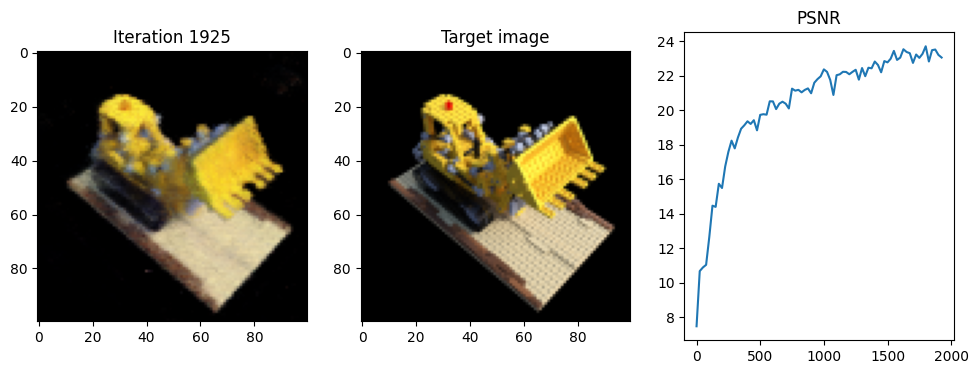

Iteration 1950  Loss: 0.0025  PSNR: 23.44  Time: 0.89 secs per iter,  29.24 mins in total


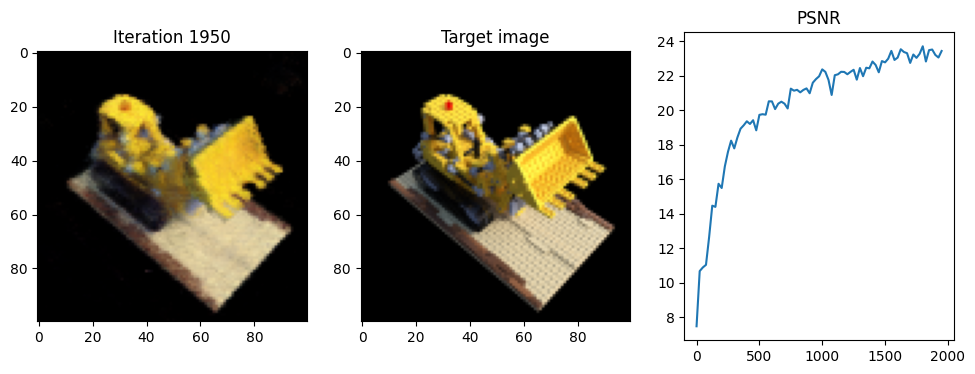

Iteration 1975  Loss: 0.0043  PSNR: 23.15  Time: 0.90 secs per iter,  29.62 mins in total


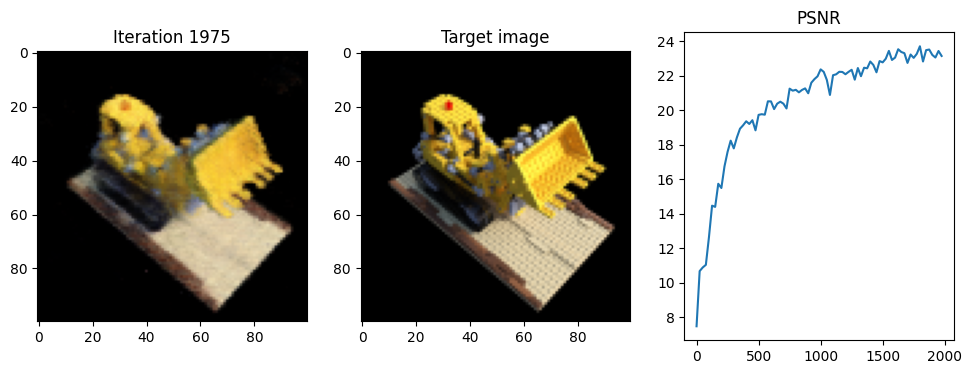

Iteration 2000  Loss: 0.0037  PSNR: 22.62  Time: 0.89 secs per iter,  29.98 mins in total


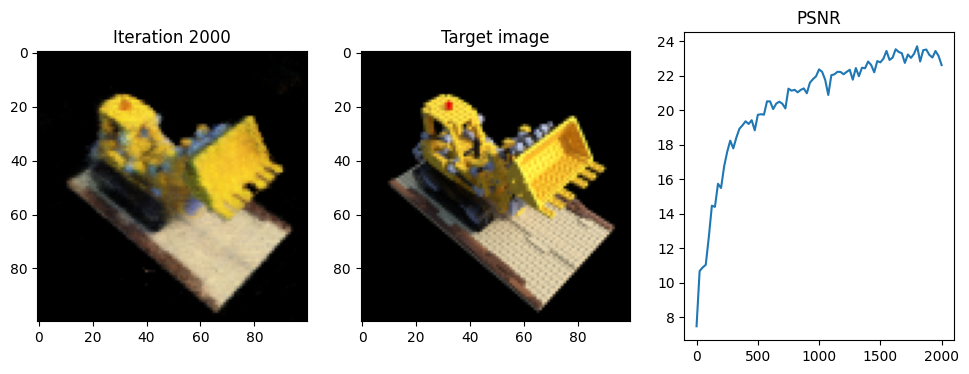

Iteration 2025  Loss: 0.0032  PSNR: 24.11  Time: 0.90 secs per iter,  30.36 mins in total


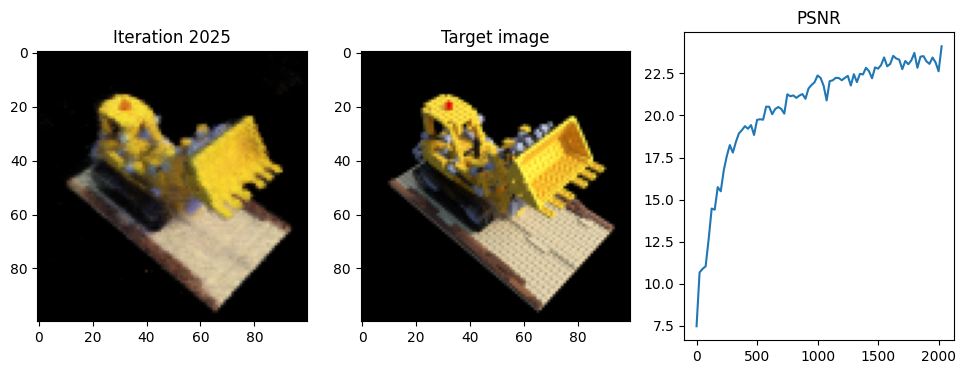

Iteration 2050  Loss: 0.0041  PSNR: 23.75  Time: 0.89 secs per iter,  30.73 mins in total


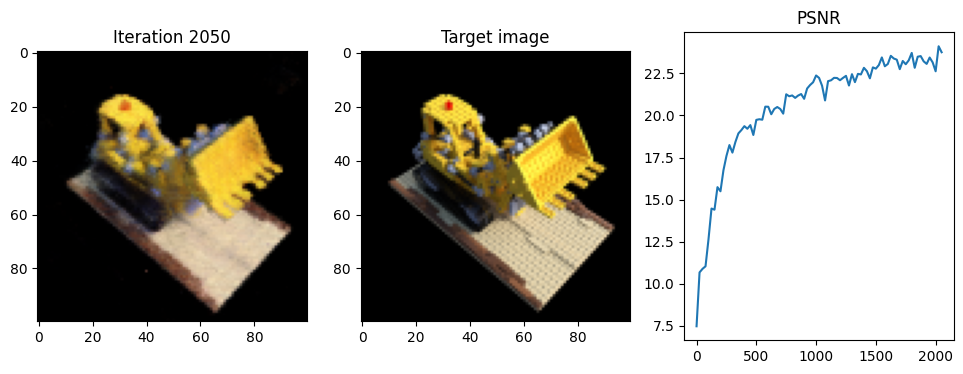

Iteration 2075  Loss: 0.0044  PSNR: 23.15  Time: 0.89 secs per iter,  31.10 mins in total


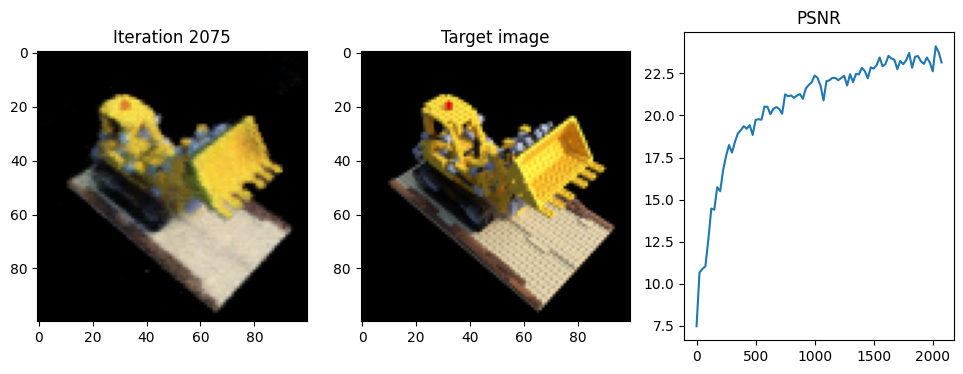

Iteration 2100  Loss: 0.0039  PSNR: 22.97  Time: 0.90 secs per iter,  31.47 mins in total


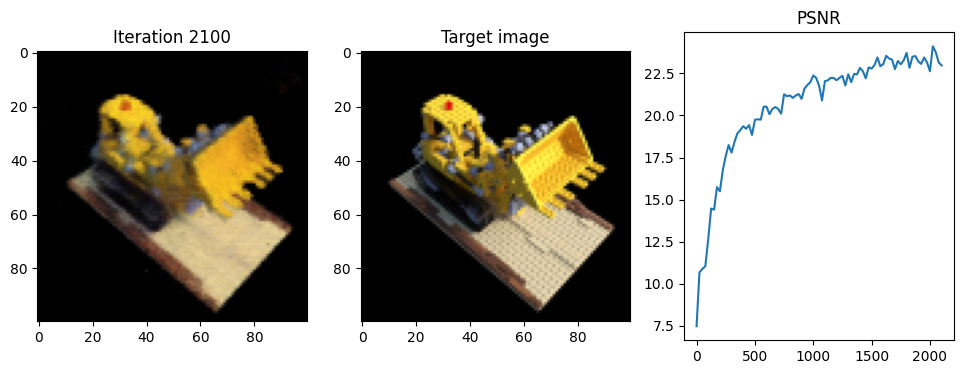

Iteration 2125  Loss: 0.0027  PSNR: 23.86  Time: 0.90 secs per iter,  31.85 mins in total


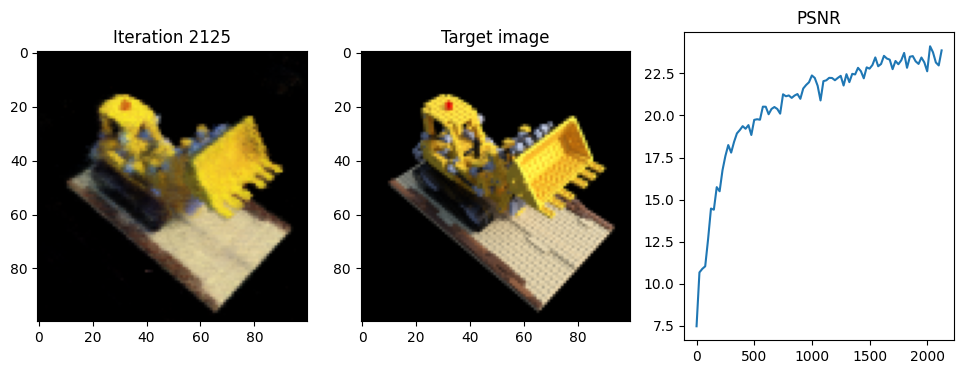

Iteration 2150  Loss: 0.0029  PSNR: 23.74  Time: 0.89 secs per iter,  32.22 mins in total


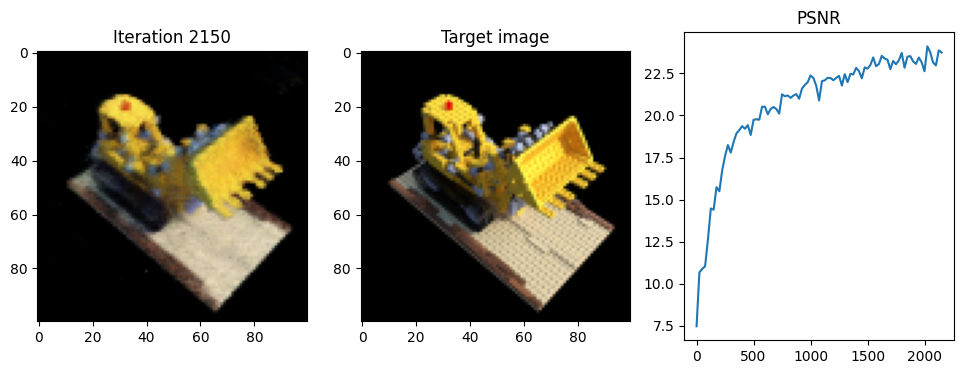

Iteration 2175  Loss: 0.0046  PSNR: 24.09  Time: 0.90 secs per iter,  32.59 mins in total


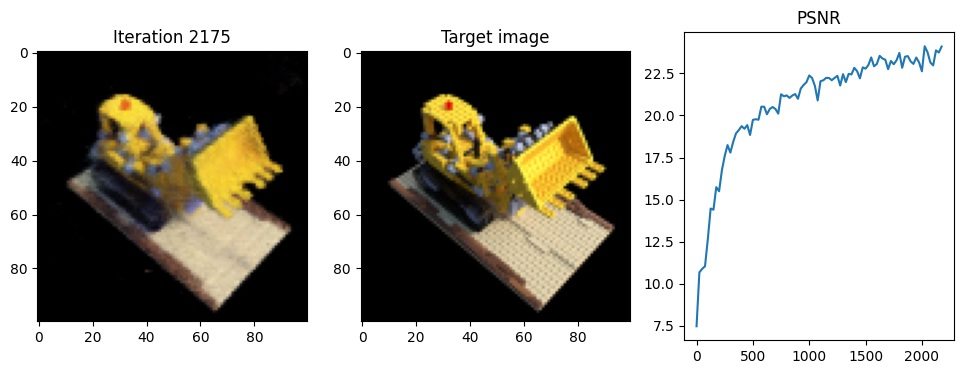

Iteration 2200  Loss: 0.0027  PSNR: 24.14  Time: 0.89 secs per iter,  32.96 mins in total


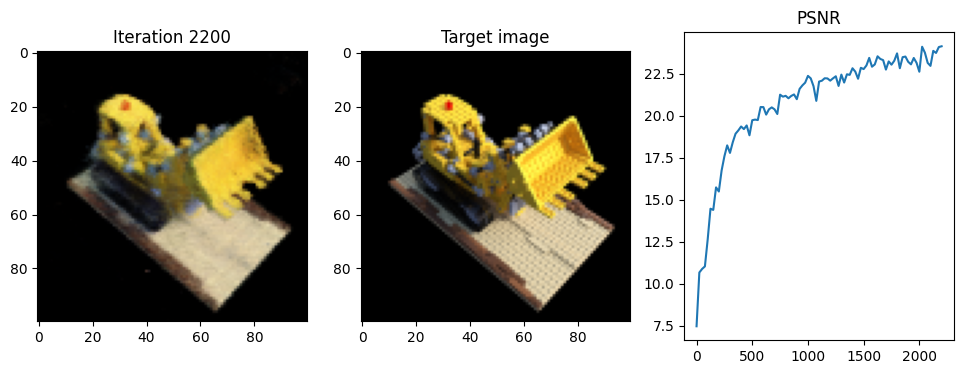

Iteration 2225  Loss: 0.0031  PSNR: 23.98  Time: 0.90 secs per iter,  33.33 mins in total


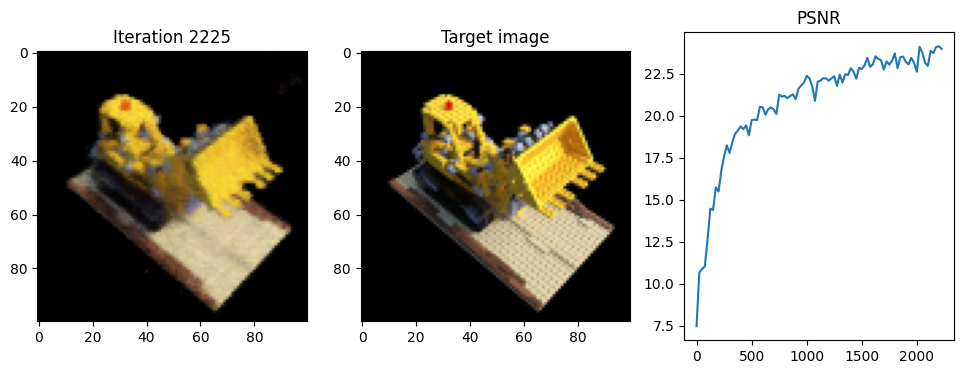

Iteration 2250  Loss: 0.0036  PSNR: 23.90  Time: 0.89 secs per iter,  33.70 mins in total


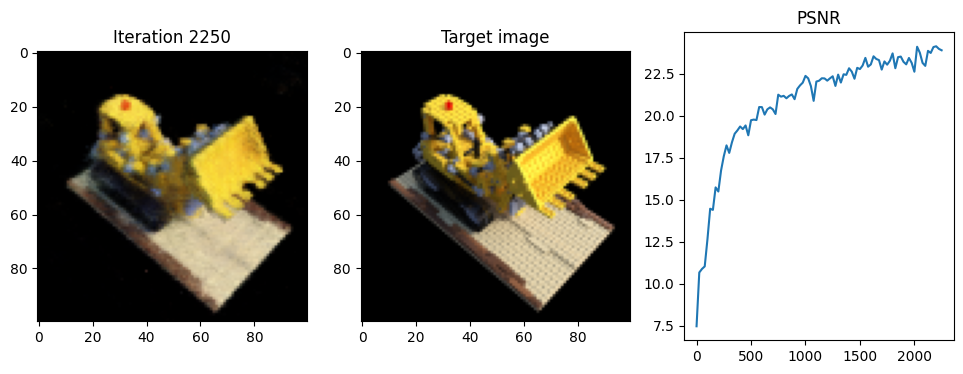

Iteration 2275  Loss: 0.0027  PSNR: 24.28  Time: 0.89 secs per iter,  34.07 mins in total


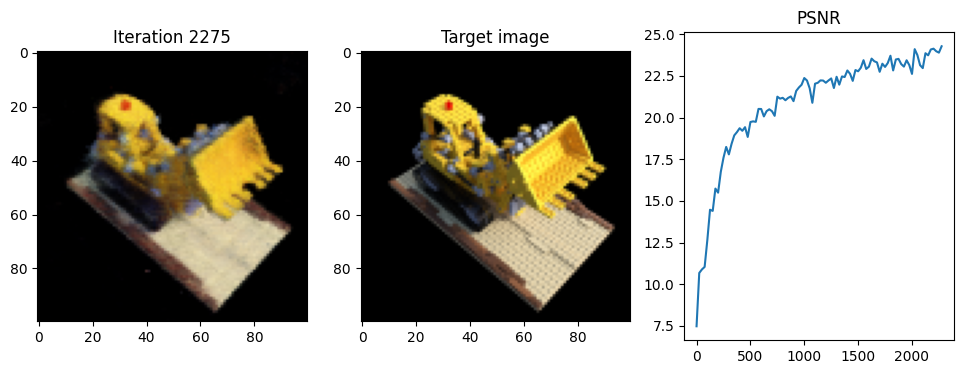

Iteration 2300  Loss: 0.0041  PSNR: 23.63  Time: 0.89 secs per iter,  34.44 mins in total


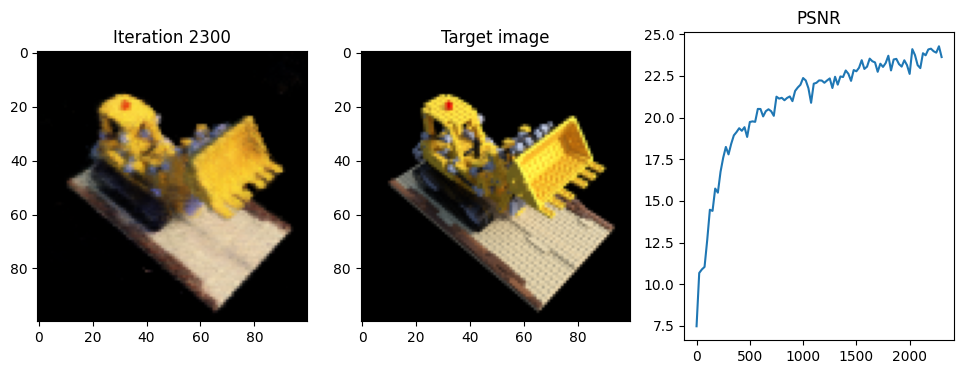

Iteration 2325  Loss: 0.0035  PSNR: 24.14  Time: 0.89 secs per iter,  34.81 mins in total


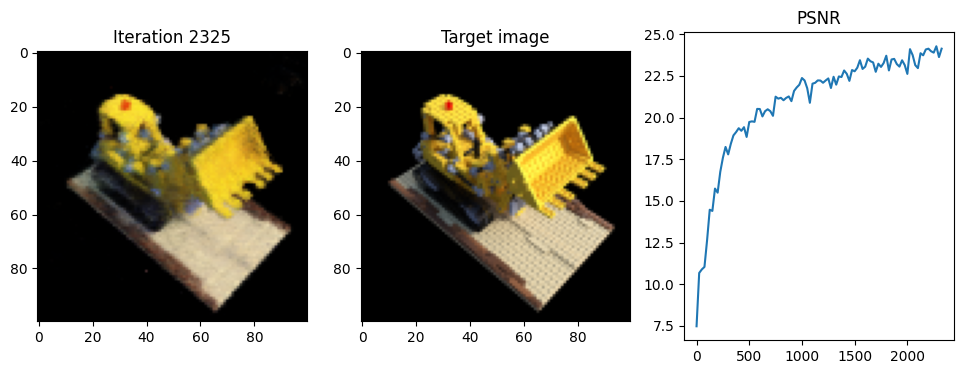

Iteration 2350  Loss: 0.0032  PSNR: 23.21  Time: 0.89 secs per iter,  35.18 mins in total


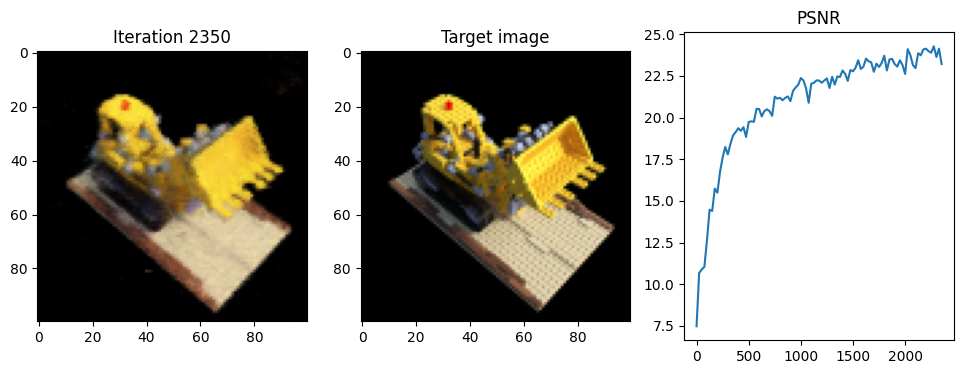

Iteration 2375  Loss: 0.0025  PSNR: 23.50  Time: 0.89 secs per iter,  35.55 mins in total


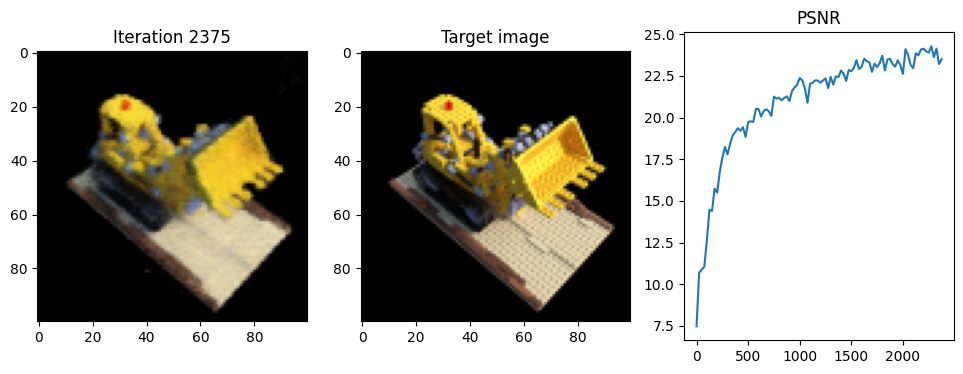

Iteration 2400  Loss: 0.0021  PSNR: 23.98  Time: 0.89 secs per iter,  35.92 mins in total


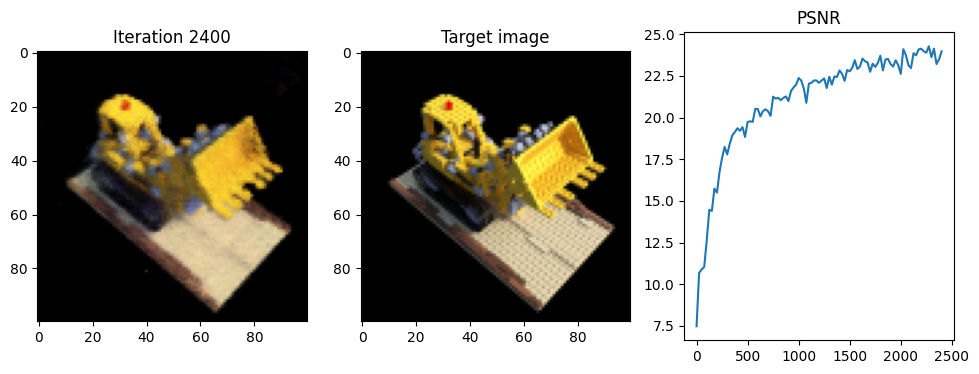

Iteration 2425  Loss: 0.0035  PSNR: 23.84  Time: 0.90 secs per iter,  36.30 mins in total


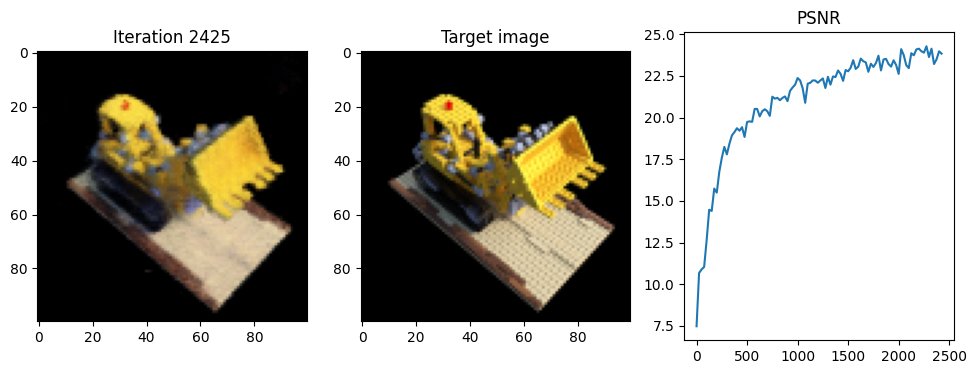

Iteration 2450  Loss: 0.0024  PSNR: 24.28  Time: 0.89 secs per iter,  36.67 mins in total


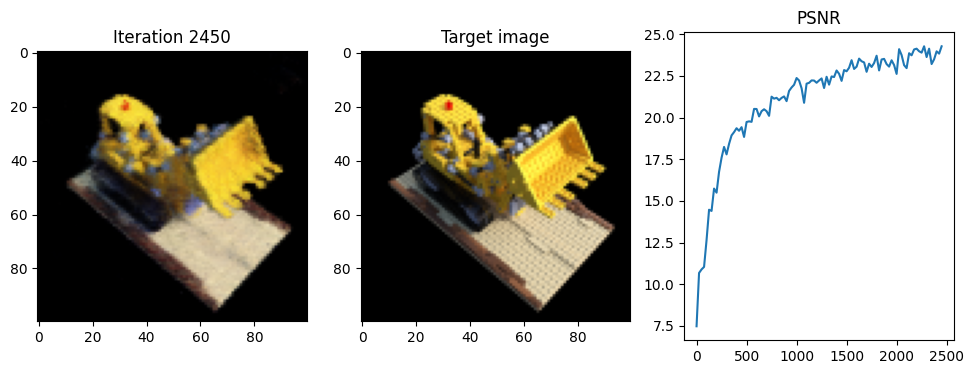

Iteration 2475  Loss: 0.0025  PSNR: 23.71  Time: 0.90 secs per iter,  37.04 mins in total


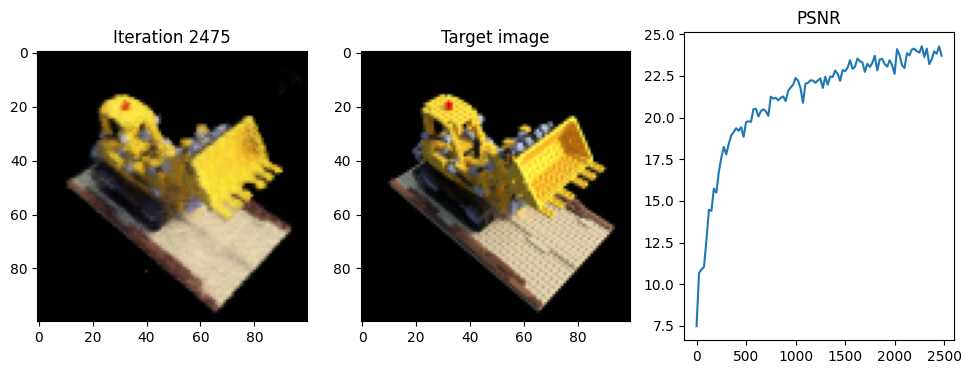

Iteration 2500  Loss: 0.0025  PSNR: 23.37  Time: 0.88 secs per iter,  37.41 mins in total


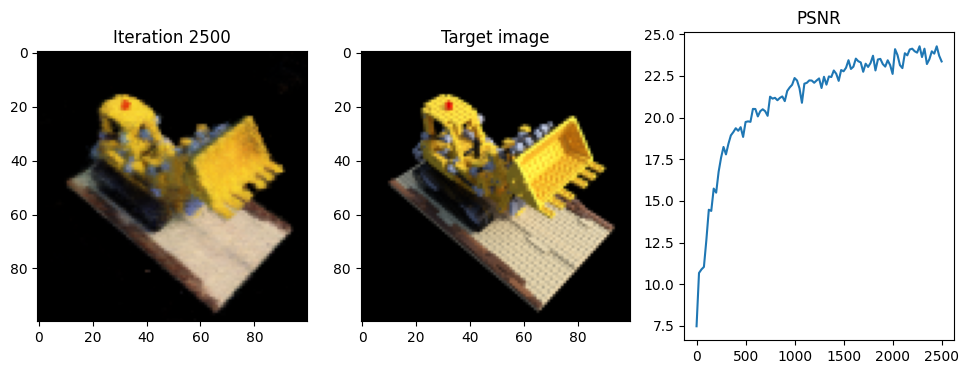

Iteration 2525  Loss: 0.0018  PSNR: 23.73  Time: 0.89 secs per iter,  37.78 mins in total


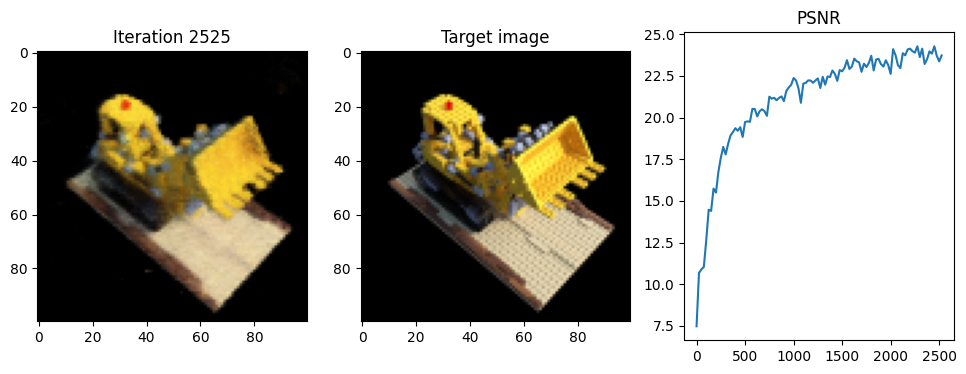

Iteration 2550  Loss: 0.0030  PSNR: 23.41  Time: 0.89 secs per iter,  38.15 mins in total


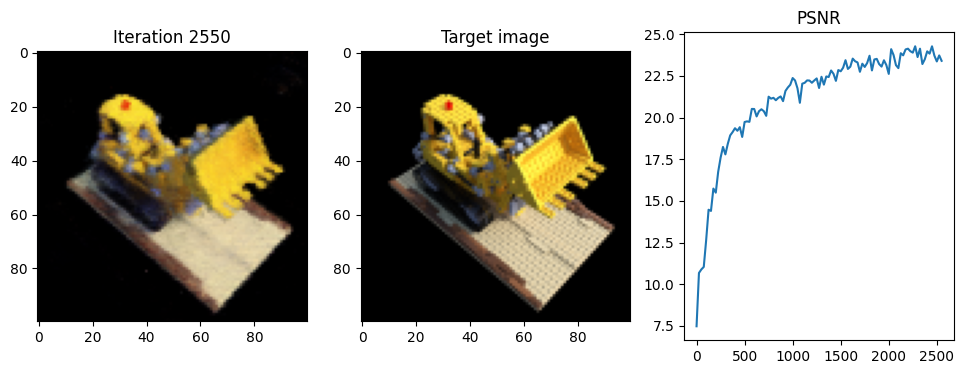

Iteration 2575  Loss: 0.0025  PSNR: 23.66  Time: 0.89 secs per iter,  38.52 mins in total


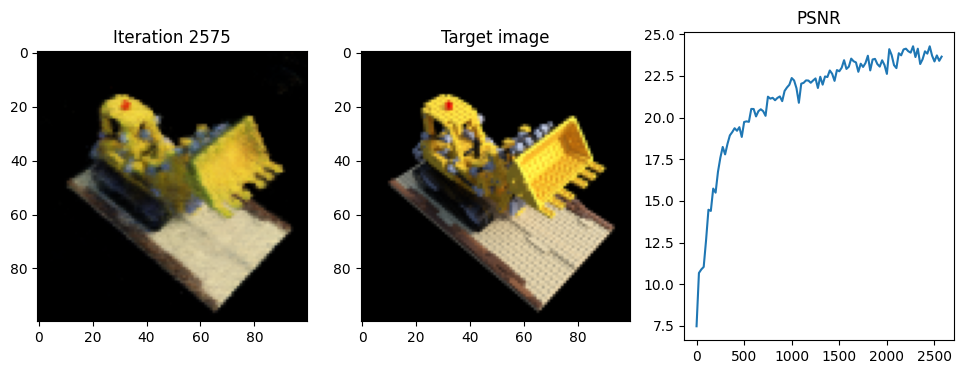

Iteration 2600  Loss: 0.0031  PSNR: 24.23  Time: 0.90 secs per iter,  38.90 mins in total


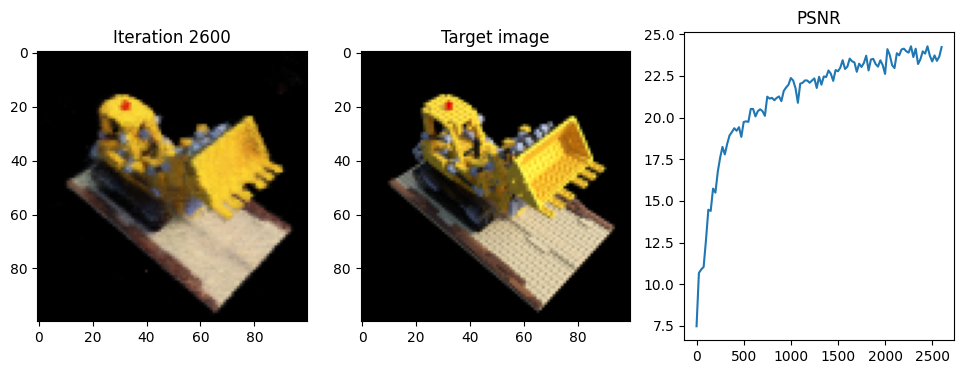

Iteration 2625  Loss: 0.0027  PSNR: 24.08  Time: 0.89 secs per iter,  39.26 mins in total


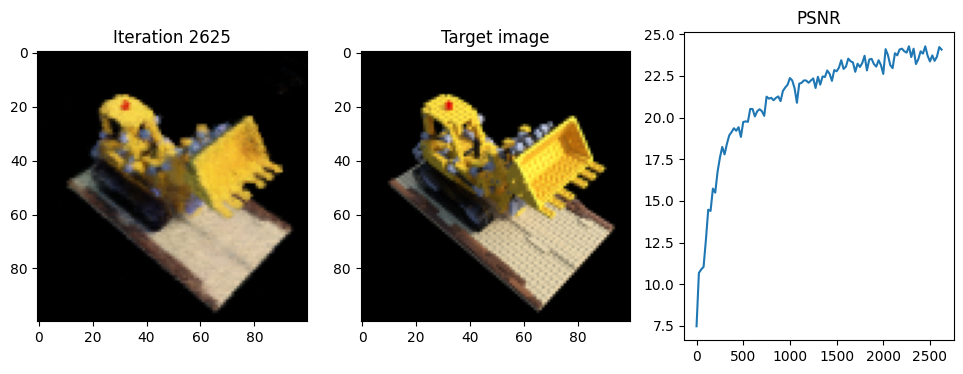

Iteration 2650  Loss: 0.0028  PSNR: 23.48  Time: 0.89 secs per iter,  39.63 mins in total


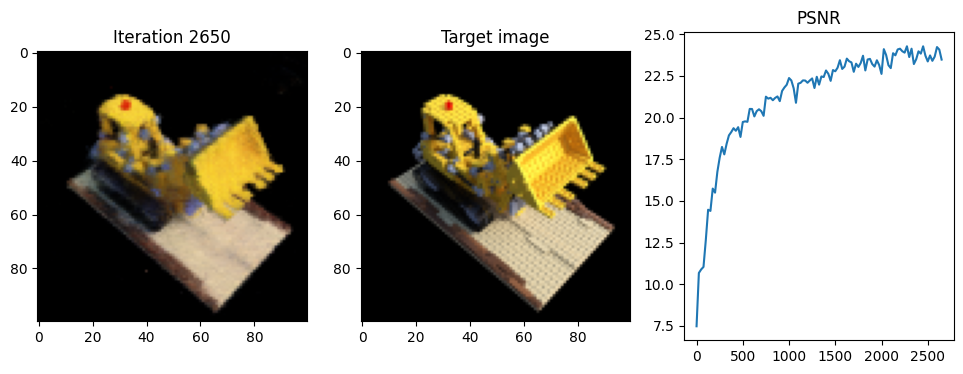

Iteration 2675  Loss: 0.0031  PSNR: 23.97  Time: 0.89 secs per iter,  40.01 mins in total


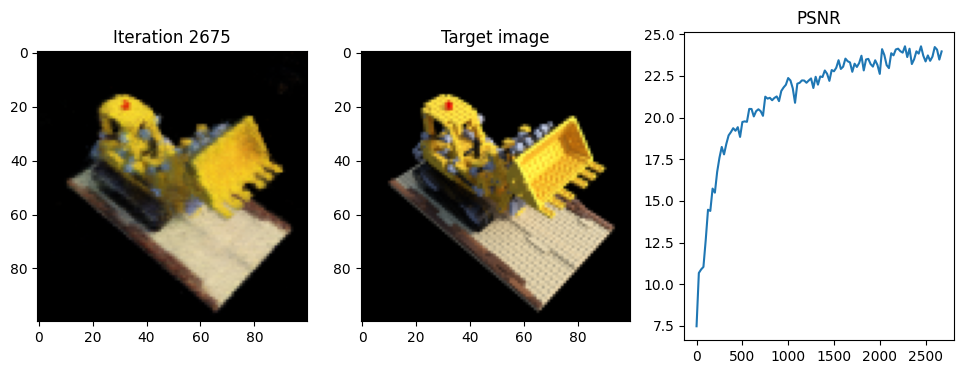

Iteration 2700  Loss: 0.0017  PSNR: 24.06  Time: 0.90 secs per iter,  40.38 mins in total


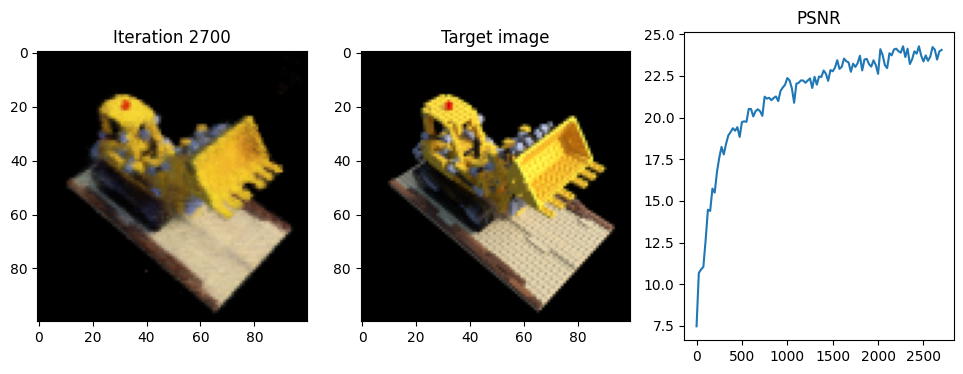

Iteration 2725  Loss: 0.0026  PSNR: 24.36  Time: 0.89 secs per iter,  40.75 mins in total


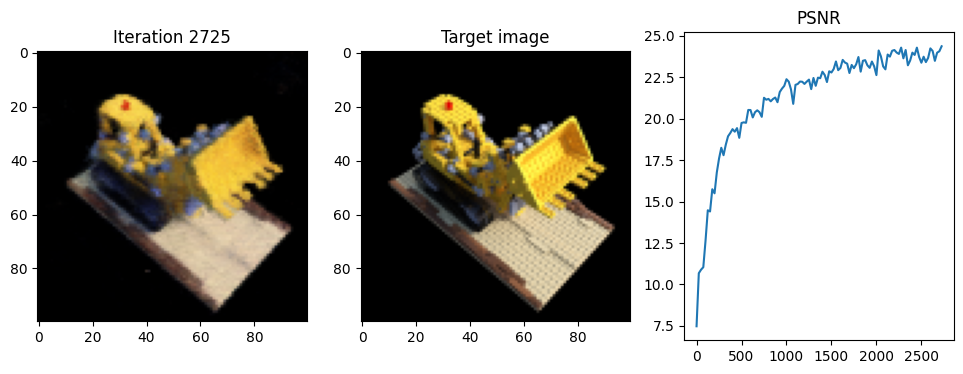

Iteration 2750  Loss: 0.0016  PSNR: 24.14  Time: 0.90 secs per iter,  41.13 mins in total


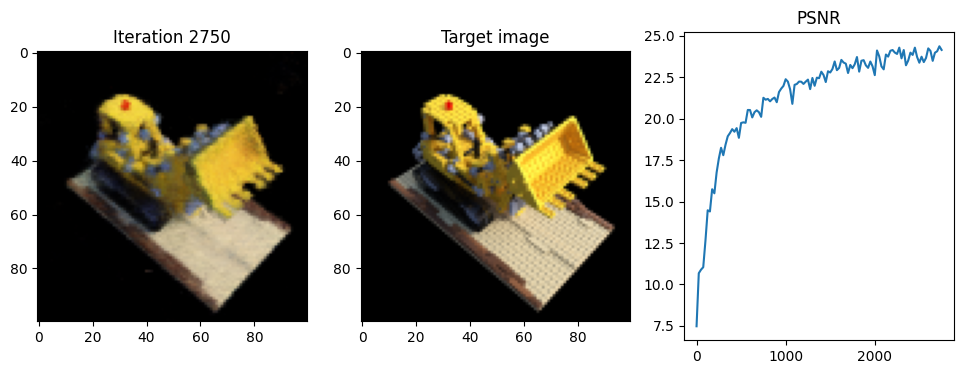

Iteration 2775  Loss: 0.0017  PSNR: 23.83  Time: 0.89 secs per iter,  41.50 mins in total


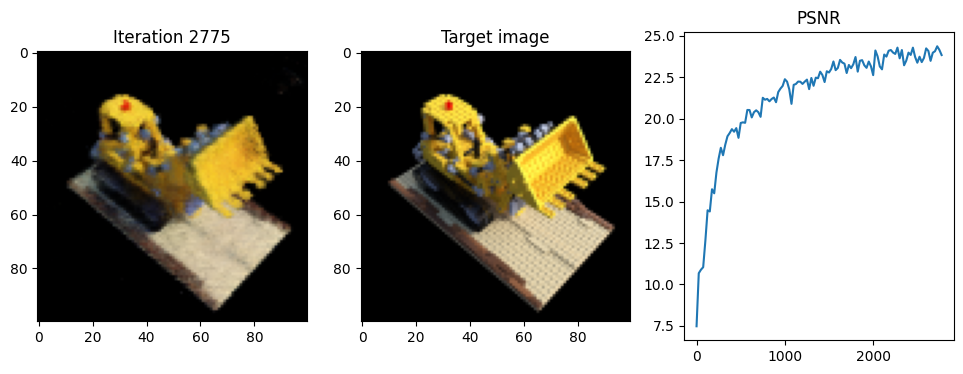

Iteration 2800  Loss: 0.0018  PSNR: 24.59  Time: 0.88 secs per iter,  41.86 mins in total


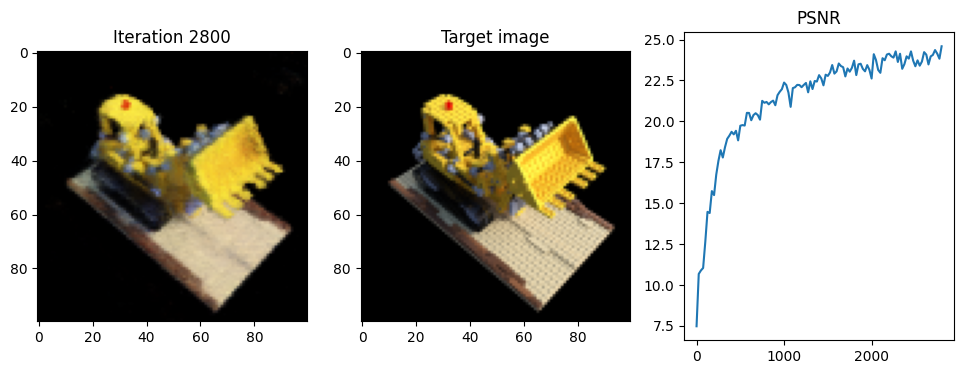

Iteration 2825  Loss: 0.0028  PSNR: 24.19  Time: 0.89 secs per iter,  42.24 mins in total


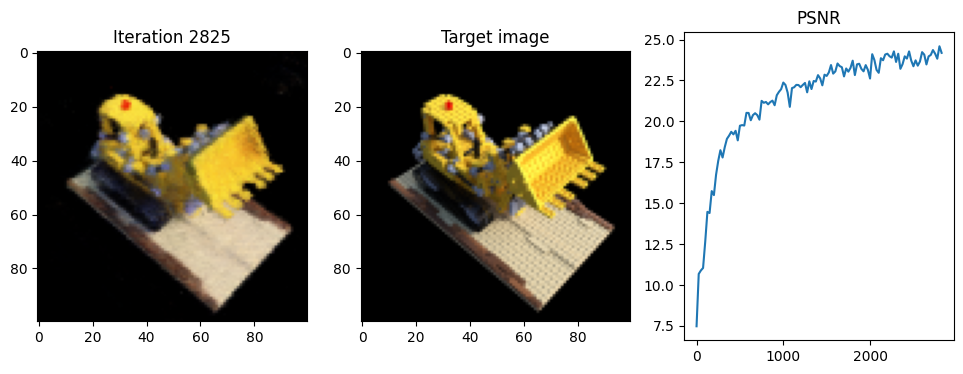

Iteration 2850  Loss: 0.0038  PSNR: 23.94  Time: 0.89 secs per iter,  42.61 mins in total


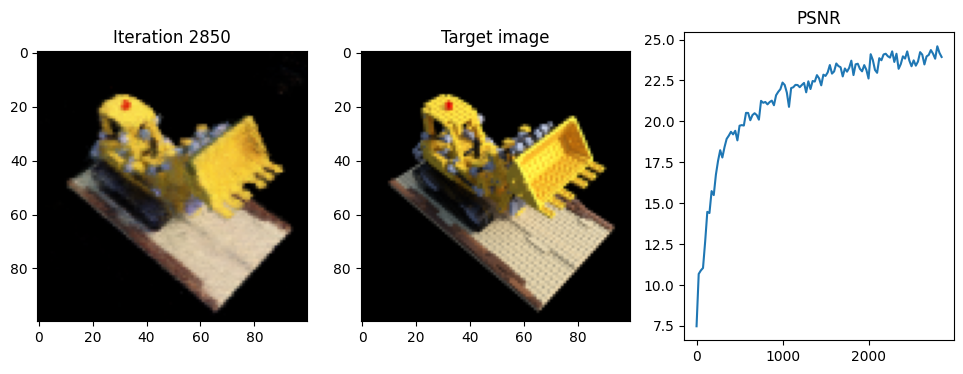

Iteration 2875  Loss: 0.0014  PSNR: 24.52  Time: 0.89 secs per iter,  42.98 mins in total


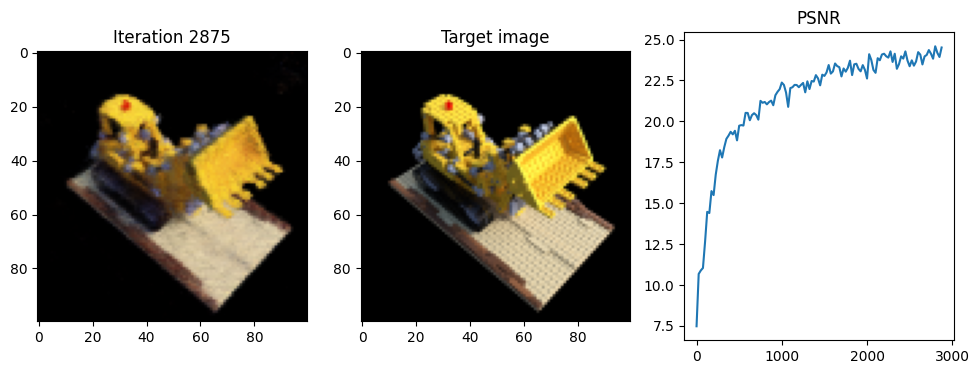

Iteration 2900  Loss: 0.0026  PSNR: 24.51  Time: 0.90 secs per iter,  43.35 mins in total


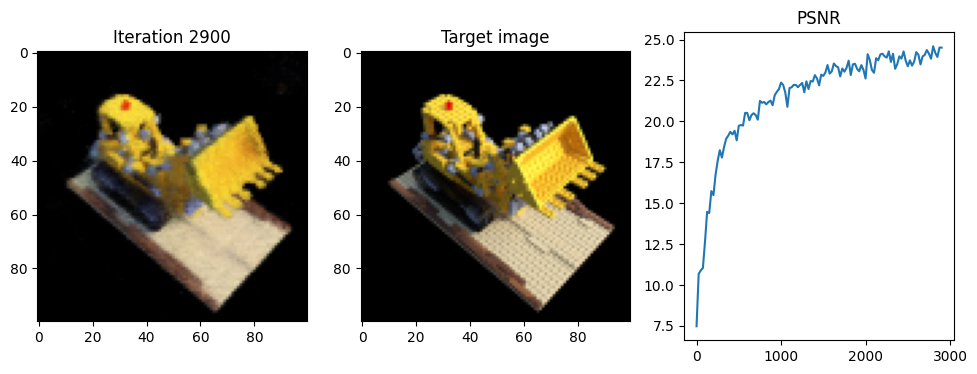

Iteration 2925  Loss: 0.0028  PSNR: 24.50  Time: 0.89 secs per iter,  43.72 mins in total


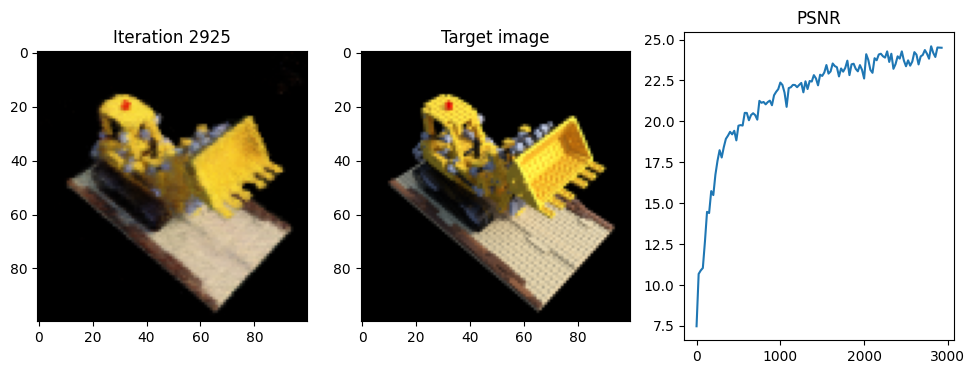

Iteration 2950  Loss: 0.0023  PSNR: 24.57  Time: 0.90 secs per iter,  44.09 mins in total


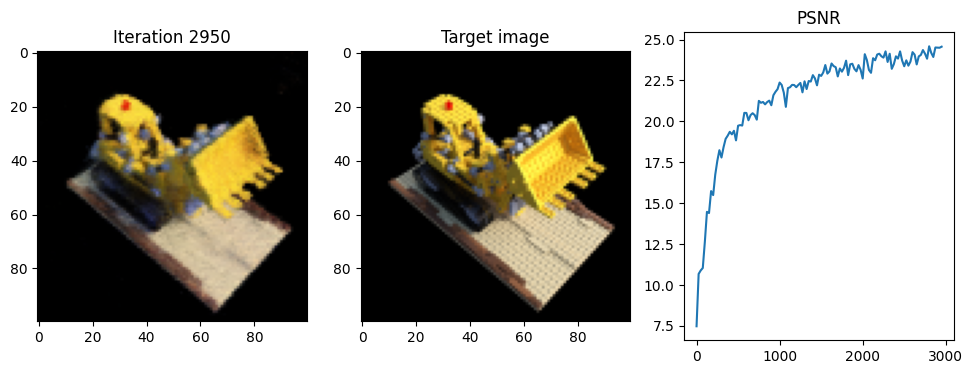

Iteration 2975  Loss: 0.0025  PSNR: 23.37  Time: 0.89 secs per iter,  44.46 mins in total


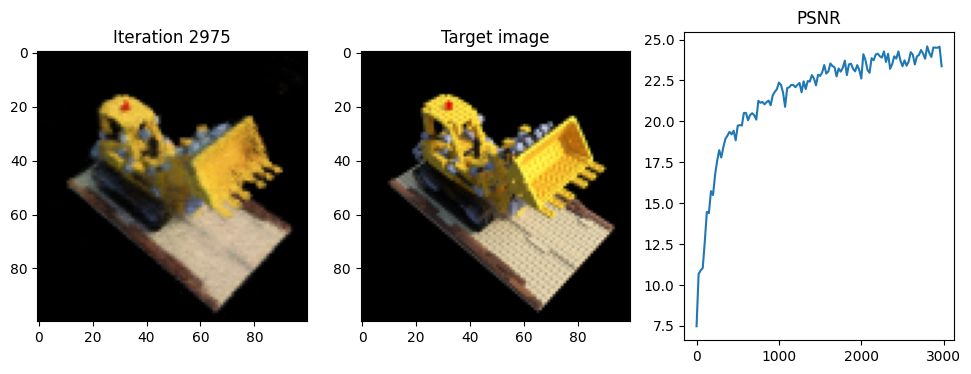

Iteration 3000  Loss: 0.0033  PSNR: 24.83  Time: 0.89 secs per iter,  44.84 mins in total


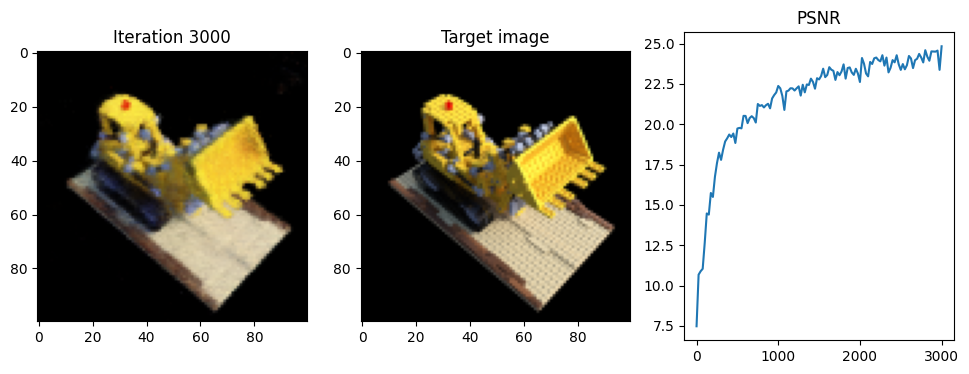

Done!


In [ ]:
num_x_frequencies = 10
num_d_frequencies = 4
learning_rate  = 5e-4
iterations = 3000
samples = 64
display = 25
near = 0.667
far = 2

model = nerf_model(num_x_frequencies=num_x_frequencies,num_d_frequencies=num_d_frequencies).to(device)

def weights_init(m):
    if isinstance(m, torch.nn.Linear):
        torch.nn.init.xavier_uniform_(m.weight)
model.apply(weights_init)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

psnrs = []
iternums = []

t = time.time()
t0 = time.time()
for i in range(iterations+1):

    #############################  TODO 2.6 BEGIN  ############################

    #choose randomly a picture for the forward pass
    device = intrinsics.device
    ray_directions = torch.zeros((height, width, 3), device=device)
    ray_origins = torch.zeros((height, width, 3), device=device)
    random_index = torch.randint(0, len(images), size=(1,)).item()
    selected_image = images[random_index]
    selected_pose = poses[random_index]


    # Run one iteration of NeRF and get the rendered RGB image.
    rec_image = one_forward_pass(height, width, intrinsics, selected_pose, near, far, samples, model, num_x_frequencies, num_d_frequencies)
    # Compute mean-squared error between the predicted and target images. Backprop!

    loss = F.mse_loss(rec_image, selected_image)
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()



    #############################  TODO 2.6 END  ############################

    # Display images/plots/stats
    if i % display == 0:
        with torch.no_grad():
        #############################  TODO 2.6 BEGIN  ############################
            # Render the held-out view

            test_rec_image = one_forward_pass(height, width, intrinsics, test_pose, near, far, samples, model, num_x_frequencies, num_d_frequencies)

        #calculate the loss and the psnr between the original test image and the reconstructed one.
            test_loss = F.mse_loss(test_rec_image, test_image)
            psnr = 10 * math.log10(1 / test_loss.item())

        #############################  TODO 2.6 END  ############################

        print("Iteration %d " % i, "Loss: %.4f " % loss.item(), "PSNR: %.2f " % psnr, \
                    "Time: %.2f secs per iter, " % ((time.time() - t) / display), "%.2f mins in total" % ((time.time() - t0)/60))

        t = time.time()
        psnrs.append(psnr)
        iternums.append(i)

        plt.figure(figsize=(16, 4))
        plt.subplot(141)
        plt.imshow(test_rec_image.detach().cpu().numpy())
        plt.title(f"Iteration {i}")
        plt.subplot(142)
        plt.imshow(test_image.detach().cpu().numpy())
        plt.title("Target image")
        plt.subplot(143)
        plt.plot(iternums, psnrs)
        plt.title("PSNR")
        plt.show()

plt.imsave('test_lego.png',test_rec_image.detach().cpu().numpy())
torch.save(model.state_dict(),'model_nerf.pt')
print('Done!')